# Session (466029_f3_stage2_day12)

# Processing of Raw Calcium Cortical Data into dFF tiff Stacks

In [1]:
"""install the packages to run this code"""
#%pip install matplotlib tifffile scipy tqdm pybaselines opencv-python imagecodecs pickle #plotly #need to do this through conda install

'install the packages to run this code'

In [2]:
session = "466029_f3_stage2_day12" #cageID_mouseID_stage_day

## Step 1: importing the proper libraries

note: all packaged are compatible with Python 3.12 as of 2024, Feb 22

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import tifffile
import cv2
from scipy import interpolate
from scipy.interpolate import interp1d
from scipy.ndimage import gaussian_filter
from scipy.signal import cheby1, filtfilt, find_peaks, peak_widths
import scipy
from tqdm import tqdm
%matplotlib inline
import plotly.express as px
import imagecodecs
from matplotlib.animation import FuncAnimation
import pickle
from pybaselines import Baseline
import pandas as pd
from ipywidgets import interact, FloatSlider
import matplotlib.gridspec as gridspec

from preprocessing_functions import (load_frames, 
                                        interactive_plot, 
                                        plot_frame, 
                                        temporal_mean, 
                                        remove_dark_frames, 
                                        extract_artifacts, 
                                        interpolate, 
                                        dff, 
                                        smoothing, 
                                        save_tiff,
                                        load_txt,
                                        extract_txt_flashes,
                                        load_masks, 
                                        avg_trials,
                                        extract_v1,
                                        animate_figure, 
extract_success,
sort_success,
extract_nogo)

## Step 2: importing and exporting from the script

### 2A: Manual importing data and paths

Please insert the file path for the tif stack as a 3d array

In [4]:
missing_artifacts = "TRUE"

In [5]:
cohort = "3_third_cohort"

### 2B: Manual Exporting data path

In [6]:
parts = session.split("_") # Split the string by underscores

cageID_mouseID = f"{parts[0]}_{parts[1]}" #cageID_mouseID
cageID, mouseID = parts[0], parts[1] #newv2
day = parts[3]  # what day of the stage they are in

print(f"cageID_mouseID = \"{cageID_mouseID}\"")
print(f"day = \"{day}\"")

cageID_mouseID = "466029_f3"
day = "day12"


### 2C: autonomous loadings and exporting lines !do not need to manipulate!

#### 2C.1: loading frames in

In [7]:
common_cortical_path = "X:/RaymondLab/1_Kai/1_cortical_data/"

In [8]:
video = f"{common_cortical_path}/{cohort}/stage2/{session}.tif"

In [9]:
frame_number = 6000 #please insert frame number to view
frames = load_frames(video); #loading in tif stack, this will take a little while

loading video, please wait...


dimensions are (35313, 128, 128) as a uint16


#### 2C.2: Tiff stack (spatial view videos) export

make sure folders exists: files are organized by common_tiff_path -> stage -> day -> full,single,double -> File_name(cage_mouseid_stage_day_condition)

In [10]:
common_tiff_path = "X:/RaymondLab/1_Kai/3_processed_data/1_tiff_stacks/stage2/"

In [11]:
tiff_path_full = f"{common_tiff_path}{day}/full_frame/{cageID_mouseID}_stage2_{day}_full_frame.tiff"
tiff_path_single = f"{common_tiff_path}{day}/single/{cageID_mouseID}_stage2_{day}_single.tiff"
tiff_path_double = f"{common_tiff_path}{day}/double/{cageID_mouseID}_stage2_{day}_double.tiff"

#### 2C.3: Pickle export timeseries array

make sure folders exist: files are organized by common_pickle_path -> stage -> day -> single,double -> ROI -> File_name(cage_mouseid_stage_day_condition)

In [12]:
common_pickle_path = "X:/RaymondLab/1_Kai/3_processed_data/2_pickle/stage2/"

In [13]:
pickle_single_v1 = f"{common_pickle_path}{day}/single/v1/{cageID_mouseID}_stage2_{day}_single_v1.pickle"
pickle_double_v1 = f"{common_pickle_path}{day}/double/v1/{cageID_mouseID}_stage2_{day}_double_v1.pickle"

pickle_single_success_ff = f"{common_pickle_path}single/success/full_frame/{cageID_mouseID}_stage2_{day}_single_success_ff.pickle"
pickle_double_success_ff = f"{common_pickle_path}double/success/full_frame/{cageID_mouseID}_stage2_{day}_double_success_ff.pickle"
pickle_nogo_success_ff = f"{common_pickle_path}nogo/success/full_frame/{cageID_mouseID}_stage2_{day}_nogo_success_ff.pickle"

pickle_single_fail_ff = f"{common_pickle_path}single/fail/full_frame/{cageID_mouseID}_stage2_{day}_single_fail_ff.pickle"
pickle_double_fail_ff = f"{common_pickle_path}double/fail/full_frame/{cageID_mouseID}_stage2_{day}_double_fail_ff.pickle"
pickle_nogo_fail_ff = f"{common_pickle_path}nogo/fail/full_frame/{cageID_mouseID}_stage2_{day}_nogo_fail_ff.pickle"

## Step 3: Plot of Raw Frames and Timecourse

### 3A: Plotting raw frame example, to make sure the tif stack loaded in properly.


Make sure the frames are a 3d array, two figures will be generated, a greyscaled and colormapped. They are technically identical

frame number 6000 plotted


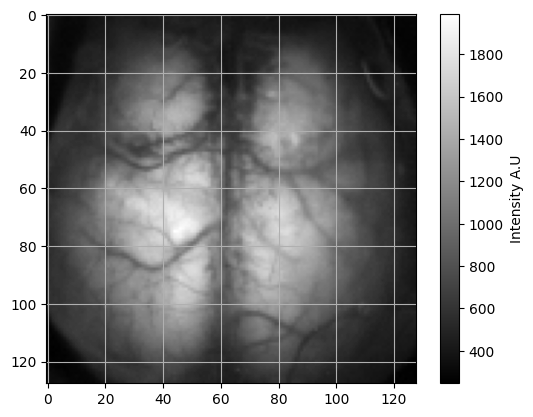

frame number 6000 plotted


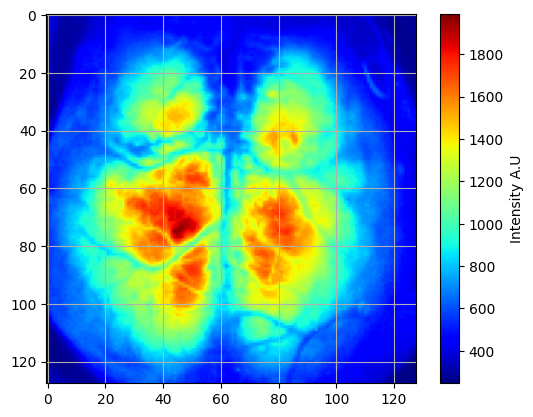

In [14]:
plot_frame(frames, frame_number, cmap = 'grey', color_label = "Intensity A.U")
plot_frame(frames, frame_number, cmap = 'jet', color_label = "Intensity A.U")

### 3B: Plot of the raw signal mean for each frame over the length of the experiment

Mean time course of the raw signal

In [15]:
mean_timecourse = temporal_mean(frames);

default 20% threshold is 251.04931640625 Determine if adjustments need to be made


## Step 4: Mean Timecourse without Darkframes at Start and End

#### 4A: plot of timecourse

#### 4B: number of single and double flashes as well as total number.

In [16]:
darkf_removed = remove_dark_frames(frames, mean_timecourse, 0.35)
darkf_removed_timecourse, darkf_removed_frames = darkf_removed[0], darkf_removed[1] #first one is the timecourse with no 3d, second is the 3d array

threshold determined to be: 282.43048095703125


#### 4C: pybaselines (only run if missing flashes)

Number of double_flash: 78
Number of double_flash pairs: 39
Number of single_flash: 34
Number of total flashes: 112


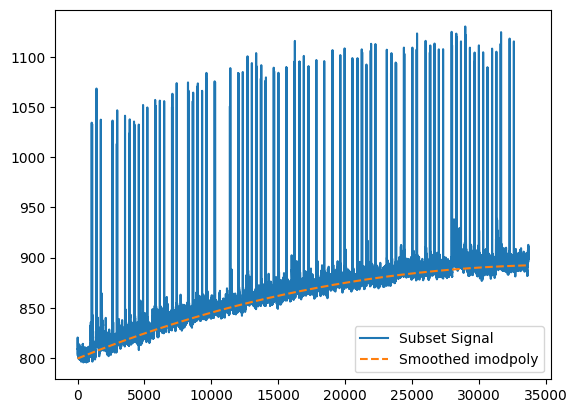

In [17]:
if missing_artifacts == "TRUE":
    x = np.linspace(0, len(darkf_removed_timecourse), len(darkf_removed_timecourse))
    baseline_fitter = Baseline(x_data=x)

    smoothed_imodpoly = baseline_fitter.imodpoly(darkf_removed_timecourse, poly_order=3, num_std=0.7)[0]
    flattened = darkf_removed_timecourse-smoothed_imodpoly

    artifacts = extract_artifacts(flattened)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

    #plotting moving mean and signal
    fig = px.line(y = [flattened])
    fig.update_layout(
    title= "mean timecourse with moving average overlay",
    xaxis=dict(title="frame number (30 fps)"),
    yaxis=dict(title="intensity value (A.U)"),
    xaxis_rangeslider_visible=True,
    showlegend=True)

    fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

    fig.show()

    plt.figure()
    plt.plot(darkf_removed_timecourse, label='Subset Signal')
    plt.plot(smoothed_imodpoly, '--', label='Smoothed imodpoly')
    plt.legend()
    plt.show()

!! If the total does not match the single and double combined, check dataset!!

In [18]:
if missing_artifacts == "FALSE": #newv2
    artifacts = extract_artifacts(darkf_removed_timecourse)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

## Step 5: Artifact Removal and DFF

### 5A: Plot of mean timecourse with artifacts removed


plot is generated with interpolated frames where the artifacts were, approximately 5 frames

In [19]:
no_artifact_timecourse = interpolate(darkf_removed_frames, artifact_indices, 5)

interpolating artifact frames...


  0%|                                                                                          | 0/112 [00:00<?, ?it/s]

  1%|▋                                                                                 | 1/112 [00:01<02:39,  1.44s/it]

  2%|█▍                                                                                | 2/112 [00:02<02:40,  1.46s/it]

  3%|██▏                                                                               | 3/112 [00:04<02:30,  1.38s/it]

  4%|██▉                                                                               | 4/112 [00:05<02:29,  1.38s/it]

  4%|███▋                                                                              | 5/112 [00:06<02:26,  1.37s/it]

  5%|████▍                                                                             | 6/112 [00:08<02:22,  1.34s/it]

  6%|█████▏                                                                            | 7/112 [00:09<02:22,  1.36s/it]

  7%|█████▊                                                                            | 8/112 [00:10<02:20,  1.35s/it]

  8%|██████▌                                                                           | 9/112 [00:12<02:19,  1.36s/it]

  9%|███████▏                                                                         | 10/112 [00:13<02:18,  1.36s/it]

 10%|███████▉                                                                         | 11/112 [00:14<02:15,  1.34s/it]

 11%|████████▋                                                                        | 12/112 [00:16<02:13,  1.33s/it]

 12%|█████████▍                                                                       | 13/112 [00:17<02:10,  1.32s/it]

 12%|██████████▏                                                                      | 14/112 [00:18<02:10,  1.33s/it]

 13%|██████████▊                                                                      | 15/112 [00:20<02:10,  1.34s/it]

 14%|███████████▌                                                                     | 16/112 [00:21<02:11,  1.37s/it]

 15%|████████████▎                                                                    | 17/112 [00:23<02:14,  1.41s/it]

 16%|█████████████                                                                    | 18/112 [00:24<02:12,  1.40s/it]

 17%|█████████████▋                                                                   | 19/112 [00:26<02:12,  1.43s/it]

 18%|██████████████▍                                                                  | 20/112 [00:27<02:10,  1.42s/it]

 19%|███████████████▏                                                                 | 21/112 [00:28<02:05,  1.38s/it]

 20%|███████████████▉                                                                 | 22/112 [00:30<02:04,  1.38s/it]

 21%|████████████████▋                                                                | 23/112 [00:31<02:02,  1.38s/it]

 21%|█████████████████▎                                                               | 24/112 [00:32<02:01,  1.38s/it]

 22%|██████████████████                                                               | 25/112 [00:34<01:59,  1.37s/it]

 23%|██████████████████▊                                                              | 26/112 [00:35<01:58,  1.38s/it]

 24%|███████████████████▌                                                             | 27/112 [00:37<01:59,  1.40s/it]

 25%|████████████████████▎                                                            | 28/112 [00:38<01:58,  1.41s/it]

 26%|████████████████████▉                                                            | 29/112 [00:39<01:55,  1.39s/it]

 27%|█████████████████████▋                                                           | 30/112 [00:41<01:53,  1.39s/it]

 28%|██████████████████████▍                                                          | 31/112 [00:42<01:49,  1.35s/it]

 29%|███████████████████████▏                                                         | 32/112 [00:44<01:51,  1.39s/it]

 29%|███████████████████████▊                                                         | 33/112 [00:45<01:51,  1.41s/it]

 30%|████████████████████████▌                                                        | 34/112 [00:47<01:51,  1.43s/it]

 31%|█████████████████████████▎                                                       | 35/112 [00:48<01:49,  1.42s/it]

 32%|██████████████████████████                                                       | 36/112 [00:49<01:46,  1.40s/it]

 33%|██████████████████████████▊                                                      | 37/112 [00:51<01:43,  1.39s/it]

 34%|███████████████████████████▍                                                     | 38/112 [00:52<01:41,  1.37s/it]

 35%|████████████████████████████▏                                                    | 39/112 [00:53<01:40,  1.37s/it]

 36%|████████████████████████████▉                                                    | 40/112 [00:55<01:38,  1.37s/it]

 37%|█████████████████████████████▋                                                   | 41/112 [00:56<01:37,  1.38s/it]

 38%|██████████████████████████████▍                                                  | 42/112 [00:57<01:35,  1.37s/it]

 38%|███████████████████████████████                                                  | 43/112 [00:59<01:34,  1.37s/it]

 39%|███████████████████████████████▊                                                 | 44/112 [01:00<01:33,  1.38s/it]

 40%|████████████████████████████████▌                                                | 45/112 [01:02<01:33,  1.39s/it]

 41%|█████████████████████████████████▎                                               | 46/112 [01:03<01:31,  1.38s/it]

 42%|█████████████████████████████████▉                                               | 47/112 [01:05<01:32,  1.42s/it]

 43%|██████████████████████████████████▋                                              | 48/112 [01:06<01:29,  1.40s/it]

 44%|███████████████████████████████████▍                                             | 49/112 [01:07<01:28,  1.41s/it]

 45%|████████████████████████████████████▏                                            | 50/112 [01:09<01:26,  1.39s/it]

 46%|████████████████████████████████████▉                                            | 51/112 [01:10<01:24,  1.38s/it]

 46%|█████████████████████████████████████▌                                           | 52/112 [01:11<01:22,  1.37s/it]

 47%|██████████████████████████████████████▎                                          | 53/112 [01:13<01:20,  1.37s/it]

 48%|███████████████████████████████████████                                          | 54/112 [01:14<01:20,  1.38s/it]

 49%|███████████████████████████████████████▊                                         | 55/112 [01:15<01:16,  1.34s/it]

 50%|████████████████████████████████████████▌                                        | 56/112 [01:17<01:15,  1.35s/it]

 51%|█████████████████████████████████████████▏                                       | 57/112 [01:18<01:14,  1.35s/it]

 52%|█████████████████████████████████████████▉                                       | 58/112 [01:20<01:17,  1.43s/it]

 53%|██████████████████████████████████████████▋                                      | 59/112 [01:21<01:13,  1.39s/it]

 54%|███████████████████████████████████████████▍                                     | 60/112 [01:22<01:11,  1.38s/it]

 54%|████████████████████████████████████████████                                     | 61/112 [01:24<01:11,  1.40s/it]

 55%|████████████████████████████████████████████▊                                    | 62/112 [01:25<01:09,  1.39s/it]

 56%|█████████████████████████████████████████████▌                                   | 63/112 [01:27<01:07,  1.38s/it]

 57%|██████████████████████████████████████████████▎                                  | 64/112 [01:28<01:07,  1.41s/it]

 58%|███████████████████████████████████████████████                                  | 65/112 [01:29<01:04,  1.38s/it]

 59%|███████████████████████████████████████████████▋                                 | 66/112 [01:31<01:05,  1.43s/it]

 60%|████████████████████████████████████████████████▍                                | 67/112 [01:32<01:03,  1.42s/it]

 61%|█████████████████████████████████████████████████▏                               | 68/112 [01:34<01:02,  1.41s/it]

 62%|█████████████████████████████████████████████████▉                               | 69/112 [01:35<01:01,  1.43s/it]

 62%|██████████████████████████████████████████████████▋                              | 70/112 [01:37<00:59,  1.43s/it]

 63%|███████████████████████████████████████████████████▎                             | 71/112 [01:38<00:57,  1.40s/it]

 64%|████████████████████████████████████████████████████                             | 72/112 [01:39<00:56,  1.40s/it]

 65%|████████████████████████████████████████████████████▊                            | 73/112 [01:41<00:54,  1.40s/it]

 66%|█████████████████████████████████████████████████████▌                           | 74/112 [01:42<00:52,  1.39s/it]

 67%|██████████████████████████████████████████████████████▏                          | 75/112 [01:43<00:50,  1.38s/it]

 68%|██████████████████████████████████████████████████████▉                          | 76/112 [01:45<00:49,  1.38s/it]

 69%|███████████████████████████████████████████████████████▋                         | 77/112 [01:46<00:48,  1.38s/it]

 70%|████████████████████████████████████████████████████████▍                        | 78/112 [01:48<00:46,  1.37s/it]

 71%|█████████████████████████████████████████████████████████▏                       | 79/112 [01:49<00:45,  1.38s/it]

 71%|█████████████████████████████████████████████████████████▊                       | 80/112 [01:50<00:43,  1.37s/it]

 72%|██████████████████████████████████████████████████████████▌                      | 81/112 [01:52<00:43,  1.40s/it]

 73%|███████████████████████████████████████████████████████████▎                     | 82/112 [01:53<00:41,  1.39s/it]

 74%|████████████████████████████████████████████████████████████                     | 83/112 [01:55<00:40,  1.40s/it]

 75%|████████████████████████████████████████████████████████████▊                    | 84/112 [01:56<00:38,  1.39s/it]

 76%|█████████████████████████████████████████████████████████████▍                   | 85/112 [01:57<00:37,  1.37s/it]

 77%|██████████████████████████████████████████████████████████████▏                  | 86/112 [01:59<00:35,  1.38s/it]

 78%|██████████████████████████████████████████████████████████████▉                  | 87/112 [02:00<00:35,  1.41s/it]

 79%|███████████████████████████████████████████████████████████████▋                 | 88/112 [02:02<00:33,  1.42s/it]

 79%|████████████████████████████████████████████████████████████████▎                | 89/112 [02:03<00:33,  1.45s/it]

 80%|█████████████████████████████████████████████████████████████████                | 90/112 [02:05<00:31,  1.45s/it]

 81%|█████████████████████████████████████████████████████████████████▊               | 91/112 [02:06<00:30,  1.47s/it]

 82%|██████████████████████████████████████████████████████████████████▌              | 92/112 [02:07<00:28,  1.44s/it]

 83%|███████████████████████████████████████████████████████████████████▎             | 93/112 [02:09<00:26,  1.41s/it]

 84%|███████████████████████████████████████████████████████████████████▉             | 94/112 [02:10<00:25,  1.44s/it]

 85%|████████████████████████████████████████████████████████████████████▋            | 95/112 [02:12<00:24,  1.43s/it]

 86%|█████████████████████████████████████████████████████████████████████▍           | 96/112 [02:13<00:22,  1.40s/it]

 87%|██████████████████████████████████████████████████████████████████████▏          | 97/112 [02:14<00:21,  1.40s/it]

 88%|██████████████████████████████████████████████████████████████████████▉          | 98/112 [02:16<00:19,  1.39s/it]

 88%|███████████████████████████████████████████████████████████████████████▌         | 99/112 [02:17<00:17,  1.37s/it]

 89%|███████████████████████████████████████████████████████████████████████▍        | 100/112 [02:18<00:16,  1.37s/it]

 90%|████████████████████████████████████████████████████████████████████████▏       | 101/112 [02:20<00:14,  1.36s/it]

 91%|████████████████████████████████████████████████████████████████████████▊       | 102/112 [02:21<00:13,  1.37s/it]

 92%|█████████████████████████████████████████████████████████████████████████▌      | 103/112 [02:23<00:12,  1.37s/it]

 93%|██████████████████████████████████████████████████████████████████████████▎     | 104/112 [02:24<00:10,  1.37s/it]

 94%|███████████████████████████████████████████████████████████████████████████     | 105/112 [02:25<00:09,  1.37s/it]

 95%|███████████████████████████████████████████████████████████████████████████▋    | 106/112 [02:27<00:08,  1.40s/it]

 96%|████████████████████████████████████████████████████████████████████████████▍   | 107/112 [02:28<00:06,  1.38s/it]

 96%|█████████████████████████████████████████████████████████████████████████████▏  | 108/112 [02:29<00:05,  1.38s/it]

 97%|█████████████████████████████████████████████████████████████████████████████▊  | 109/112 [02:31<00:04,  1.40s/it]

 98%|██████████████████████████████████████████████████████████████████████████████▌ | 110/112 [02:32<00:02,  1.40s/it]

 99%|███████████████████████████████████████████████████████████████████████████████▎| 111/112 [02:34<00:01,  1.39s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 112/112 [02:35<00:00,  1.39s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 112/112 [02:35<00:00,  1.39s/it]

### 5B: Calculating dff


Dff calculated from the 3d array without artifacts, darkframes removed, and interpolated the space where the artifacts were. Then plotting of the signal with the 10s moving mean before dff is applied. dff is applied using this moving mean onto the signal

In [20]:
dff_array = dff(no_artifact_timecourse, 10, 30);
dff_signal, moving_average = dff_array[0], dff_array[1]

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

 23%|██████████████████▏                                                             | 29/128 [00:00<00:00, 287.23it/s]

 45%|████████████████████████████████████▎                                           | 58/128 [00:00<00:00, 285.56it/s]

 68%|██████████████████████████████████████████████████████▍                         | 87/128 [00:00<00:00, 259.43it/s]

 89%|██████████████████████████████████████████████████████████████████████▎        | 114/128 [00:00<00:00, 256.72it/s]

100%|███████████████████████████████████████████████████████████████████████████████| 128/128 [00:00<00:00, 263.46it/s]

  0%|                                                                                        | 0/33689 [00:00<?, ?it/s]

  0%|                                                                              | 29/33689 [00:00<01:59, 281.65it/s]

  0%|▏                                                                             | 58/33689 [00:00<02:00, 278.47it/s]

  0%|▏                                                                             | 86/33689 [00:00<02:17, 244.29it/s]

  0%|▎                                                                            | 111/33689 [00:00<02:17, 243.75it/s]

  0%|▎                                                                            | 138/33689 [00:00<02:13, 251.76it/s]

  0%|▎                                                                            | 164/33689 [00:00<02:16, 246.47it/s]

  1%|▍                                                                            | 189/33689 [00:00<02:24, 231.82it/s]

  1%|▍                                                                            | 216/33689 [00:00<02:18, 240.90it/s]

  1%|▌                                                                            | 243/33689 [00:00<02:15, 246.57it/s]

  1%|▌                                                                            | 268/33689 [00:01<02:21, 236.52it/s]

  1%|▋                                                                            | 293/33689 [00:01<02:19, 238.68it/s]

  1%|▋                                                                            | 319/33689 [00:01<02:17, 243.45it/s]

  1%|▊                                                                            | 346/33689 [00:01<02:14, 248.30it/s]

  1%|▊                                                                            | 371/33689 [00:01<02:16, 243.85it/s]

  1%|▉                                                                            | 396/33689 [00:01<02:17, 241.27it/s]

  1%|▉                                                                            | 422/33689 [00:01<02:16, 244.59it/s]

  1%|█                                                                            | 447/33689 [00:01<02:18, 239.92it/s]

  1%|█                                                                            | 472/33689 [00:01<02:22, 233.21it/s]

  1%|█▏                                                                           | 498/33689 [00:02<02:18, 239.46it/s]

  2%|█▏                                                                           | 526/33689 [00:02<02:12, 250.40it/s]

  2%|█▎                                                                           | 552/33689 [00:02<02:20, 235.76it/s]

  2%|█▎                                                                           | 576/33689 [00:02<02:24, 229.31it/s]

  2%|█▍                                                                           | 603/33689 [00:02<02:17, 239.97it/s]

  2%|█▍                                                                           | 628/33689 [00:02<02:16, 242.15it/s]

  2%|█▍                                                                           | 654/33689 [00:02<02:14, 245.90it/s]

  2%|█▌                                                                           | 679/33689 [00:02<02:19, 236.15it/s]

  2%|█▌                                                                           | 707/33689 [00:02<02:13, 246.52it/s]

  2%|█▋                                                                           | 735/33689 [00:03<02:10, 253.24it/s]

  2%|█▋                                                                           | 761/33689 [00:03<02:17, 238.70it/s]

  2%|█▊                                                                           | 786/33689 [00:03<02:18, 237.90it/s]

  2%|█▊                                                                           | 814/33689 [00:03<02:11, 249.40it/s]

  2%|█▉                                                                           | 840/33689 [00:03<02:12, 247.50it/s]

  3%|█▉                                                                           | 866/33689 [00:03<02:11, 250.38it/s]

  3%|██                                                                           | 893/33689 [00:03<02:09, 253.88it/s]

  3%|██                                                                           | 919/33689 [00:03<02:08, 254.21it/s]

  3%|██▏                                                                          | 946/33689 [00:03<02:07, 257.35it/s]

  3%|██▏                                                                          | 972/33689 [00:03<02:08, 253.69it/s]

  3%|██▎                                                                          | 999/33689 [00:04<02:07, 256.23it/s]

  3%|██▎                                                                         | 1025/33689 [00:04<02:07, 255.86it/s]

  3%|██▎                                                                         | 1051/33689 [00:04<02:08, 254.86it/s]

  3%|██▍                                                                         | 1077/33689 [00:04<02:16, 238.21it/s]

  3%|██▍                                                                         | 1103/33689 [00:04<02:14, 242.31it/s]

  3%|██▌                                                                         | 1131/33689 [00:04<02:09, 250.68it/s]

  3%|██▌                                                                         | 1158/33689 [00:04<02:08, 253.46it/s]

  4%|██▋                                                                         | 1184/33689 [00:04<02:13, 242.76it/s]

  4%|██▋                                                                         | 1209/33689 [00:04<02:19, 232.39it/s]

  4%|██▊                                                                         | 1233/33689 [00:05<02:19, 233.23it/s]

  4%|██▊                                                                         | 1257/33689 [00:05<02:18, 233.38it/s]

  4%|██▉                                                                         | 1283/33689 [00:05<02:15, 239.03it/s]

  4%|██▉                                                                         | 1309/33689 [00:05<02:12, 244.39it/s]

  4%|███                                                                         | 1336/33689 [00:05<02:08, 251.14it/s]

  4%|███                                                                         | 1362/33689 [00:05<02:08, 251.83it/s]

  4%|███▏                                                                        | 1389/33689 [00:05<02:06, 254.94it/s]

  4%|███▏                                                                        | 1415/33689 [00:05<02:07, 252.74it/s]

  4%|███▎                                                                        | 1441/33689 [00:05<02:08, 251.22it/s]

  4%|███▎                                                                        | 1467/33689 [00:05<02:14, 239.16it/s]

  4%|███▎                                                                        | 1492/33689 [00:06<02:15, 238.21it/s]

  4%|███▍                                                                        | 1516/33689 [00:06<02:14, 238.62it/s]

  5%|███▍                                                                        | 1540/33689 [00:06<02:16, 234.98it/s]

  5%|███▌                                                                        | 1566/33689 [00:06<02:13, 240.41it/s]

  5%|███▌                                                                        | 1592/33689 [00:06<02:10, 245.41it/s]

  5%|███▋                                                                        | 1619/33689 [00:06<02:07, 251.89it/s]

  5%|███▋                                                                        | 1645/33689 [00:06<02:10, 245.20it/s]

  5%|███▊                                                                        | 1672/33689 [00:06<02:07, 250.96it/s]

  5%|███▊                                                                        | 1698/33689 [00:06<02:06, 252.15it/s]

  5%|███▉                                                                        | 1724/33689 [00:07<02:12, 241.75it/s]

  5%|███▉                                                                        | 1751/33689 [00:07<02:08, 248.39it/s]

  5%|████                                                                        | 1777/33689 [00:07<02:07, 250.31it/s]

  5%|████                                                                        | 1804/33689 [00:07<02:05, 254.57it/s]

  5%|████▏                                                                       | 1830/33689 [00:07<02:07, 250.34it/s]

  6%|████▏                                                                       | 1856/33689 [00:07<02:16, 233.33it/s]

  6%|████▏                                                                       | 1882/33689 [00:07<02:13, 238.73it/s]

  6%|████▎                                                                       | 1909/33689 [00:07<02:08, 246.93it/s]

  6%|████▎                                                                       | 1934/33689 [00:07<02:08, 246.83it/s]

  6%|████▍                                                                       | 1959/33689 [00:07<02:08, 246.35it/s]

  6%|████▍                                                                       | 1986/33689 [00:08<02:06, 251.07it/s]

  6%|████▌                                                                       | 2012/33689 [00:08<02:11, 241.03it/s]

  6%|████▌                                                                       | 2038/33689 [00:08<02:09, 244.36it/s]

  6%|████▋                                                                       | 2063/33689 [00:08<02:13, 237.32it/s]

  6%|████▋                                                                       | 2087/33689 [00:08<02:13, 236.02it/s]

  6%|████▊                                                                       | 2112/33689 [00:08<02:11, 239.37it/s]

  6%|████▊                                                                       | 2140/33689 [00:08<02:05, 250.44it/s]

  6%|████▉                                                                       | 2166/33689 [00:08<02:07, 247.11it/s]

  7%|████▉                                                                       | 2191/33689 [00:08<02:12, 237.66it/s]

  7%|█████                                                                       | 2217/33689 [00:09<02:10, 241.96it/s]

  7%|█████                                                                       | 2244/33689 [00:09<02:06, 248.60it/s]

  7%|█████                                                                       | 2269/33689 [00:09<02:13, 234.76it/s]

  7%|█████▏                                                                      | 2294/33689 [00:09<02:12, 237.07it/s]

  7%|█████▏                                                                      | 2320/33689 [00:09<02:09, 242.23it/s]

  7%|█████▎                                                                      | 2346/33689 [00:09<02:07, 246.66it/s]

  7%|█████▎                                                                      | 2373/33689 [00:09<02:04, 251.28it/s]

  7%|█████▍                                                                      | 2399/33689 [00:09<02:03, 252.38it/s]

  7%|█████▍                                                                      | 2425/33689 [00:09<02:03, 252.42it/s]

  7%|█████▌                                                                      | 2451/33689 [00:09<02:03, 253.18it/s]

  7%|█████▌                                                                      | 2477/33689 [00:10<02:06, 246.52it/s]

  7%|█████▋                                                                      | 2502/33689 [00:10<02:08, 241.96it/s]

  8%|█████▋                                                                      | 2528/33689 [00:10<02:06, 245.75it/s]

  8%|█████▊                                                                      | 2555/33689 [00:10<02:04, 250.63it/s]

  8%|█████▊                                                                      | 2582/33689 [00:10<02:02, 253.34it/s]

  8%|█████▉                                                                      | 2608/33689 [00:10<02:07, 243.34it/s]

  8%|█████▉                                                                      | 2633/33689 [00:10<02:09, 240.07it/s]

  8%|█████▉                                                                      | 2658/33689 [00:10<02:11, 236.18it/s]

  8%|██████                                                                      | 2684/33689 [00:10<02:08, 241.58it/s]

  8%|██████                                                                      | 2709/33689 [00:11<02:10, 237.22it/s]

  8%|██████▏                                                                     | 2733/33689 [00:11<02:10, 237.96it/s]

  8%|██████▏                                                                     | 2757/33689 [00:11<02:09, 237.96it/s]

  8%|██████▎                                                                     | 2784/33689 [00:11<02:05, 246.61it/s]

  8%|██████▎                                                                     | 2809/33689 [00:11<02:05, 245.47it/s]

  8%|██████▍                                                                     | 2834/33689 [00:11<02:07, 241.16it/s]

  8%|██████▍                                                                     | 2861/33689 [00:11<02:04, 246.70it/s]

  9%|██████▌                                                                     | 2886/33689 [00:11<02:06, 242.74it/s]

  9%|██████▌                                                                     | 2912/33689 [00:11<02:06, 244.23it/s]

  9%|██████▋                                                                     | 2937/33689 [00:12<02:06, 243.81it/s]

  9%|██████▋                                                                     | 2963/33689 [00:12<02:03, 247.82it/s]

  9%|██████▋                                                                     | 2990/33689 [00:12<02:01, 252.13it/s]

  9%|██████▊                                                                     | 3016/33689 [00:12<02:05, 245.12it/s]

  9%|██████▊                                                                     | 3041/33689 [00:12<02:07, 240.33it/s]

  9%|██████▉                                                                     | 3069/33689 [00:12<02:02, 250.98it/s]

  9%|██████▉                                                                     | 3095/33689 [00:12<02:02, 250.71it/s]

  9%|███████                                                                     | 3121/33689 [00:12<02:01, 251.25it/s]

  9%|███████                                                                     | 3149/33689 [00:12<01:58, 258.14it/s]

  9%|███████▏                                                                    | 3175/33689 [00:12<02:00, 254.25it/s]

 10%|███████▏                                                                    | 3201/33689 [00:13<02:06, 241.86it/s]

 10%|███████▎                                                                    | 3228/33689 [00:13<02:02, 249.13it/s]

 10%|███████▎                                                                    | 3256/33689 [00:13<01:58, 257.27it/s]

 10%|███████▍                                                                    | 3282/33689 [00:13<01:58, 257.34it/s]

 10%|███████▍                                                                    | 3309/33689 [00:13<01:56, 260.30it/s]

 10%|███████▌                                                                    | 3336/33689 [00:13<01:58, 257.16it/s]

 10%|███████▌                                                                    | 3362/33689 [00:13<01:59, 253.28it/s]

 10%|███████▋                                                                    | 3390/33689 [00:13<01:57, 258.80it/s]

 10%|███████▋                                                                    | 3418/33689 [00:13<01:55, 262.71it/s]

 10%|███████▊                                                                    | 3445/33689 [00:13<01:55, 262.56it/s]

 10%|███████▊                                                                    | 3472/33689 [00:14<01:57, 257.24it/s]

 10%|███████▉                                                                    | 3500/33689 [00:14<01:55, 262.32it/s]

 10%|███████▉                                                                    | 3527/33689 [00:14<01:57, 256.38it/s]

 11%|████████                                                                    | 3553/33689 [00:14<01:58, 253.80it/s]

 11%|████████                                                                    | 3581/33689 [00:14<01:55, 259.88it/s]

 11%|████████▏                                                                   | 3608/33689 [00:14<01:59, 252.58it/s]

 11%|████████▏                                                                   | 3634/33689 [00:14<02:01, 246.98it/s]

 11%|████████▎                                                                   | 3659/33689 [00:14<02:02, 245.77it/s]

 11%|████████▎                                                                   | 3684/33689 [00:14<02:03, 243.52it/s]

 11%|████████▎                                                                   | 3710/33689 [00:15<02:01, 246.86it/s]

 11%|████████▍                                                                   | 3738/33689 [00:15<01:57, 255.01it/s]

 11%|████████▍                                                                   | 3765/33689 [00:15<01:55, 258.66it/s]

 11%|████████▌                                                                   | 3791/33689 [00:15<01:58, 251.69it/s]

 11%|████████▌                                                                   | 3817/33689 [00:15<02:00, 248.37it/s]

 11%|████████▋                                                                   | 3845/33689 [00:15<01:56, 256.76it/s]

 11%|████████▋                                                                   | 3871/33689 [00:15<01:58, 251.87it/s]

 12%|████████▊                                                                   | 3897/33689 [00:15<02:02, 244.02it/s]

 12%|████████▊                                                                   | 3924/33689 [00:15<01:59, 248.59it/s]

 12%|████████▉                                                                   | 3951/33689 [00:16<01:58, 251.86it/s]

 12%|████████▉                                                                   | 3978/33689 [00:16<01:56, 255.64it/s]

 12%|█████████                                                                   | 4005/33689 [00:16<01:54, 258.33it/s]

 12%|█████████                                                                   | 4033/33689 [00:16<01:53, 261.63it/s]

 12%|█████████▏                                                                  | 4060/33689 [00:16<01:52, 262.57it/s]

 12%|█████████▏                                                                  | 4088/33689 [00:16<01:50, 266.92it/s]

 12%|█████████▎                                                                  | 4116/33689 [00:16<01:49, 270.31it/s]

 12%|█████████▎                                                                  | 4144/33689 [00:16<01:55, 255.80it/s]

 12%|█████████▍                                                                  | 4170/33689 [00:16<01:55, 255.57it/s]

 12%|█████████▍                                                                  | 4196/33689 [00:16<01:55, 256.25it/s]

 13%|█████████▌                                                                  | 4223/33689 [00:17<01:54, 257.29it/s]

 13%|█████████▌                                                                  | 4249/33689 [00:17<02:01, 241.59it/s]

 13%|█████████▋                                                                  | 4276/33689 [00:17<01:58, 248.18it/s]

 13%|█████████▋                                                                  | 4302/33689 [00:17<02:00, 244.61it/s]

 13%|█████████▊                                                                  | 4327/33689 [00:17<02:01, 242.04it/s]

 13%|█████████▊                                                                  | 4352/33689 [00:17<02:05, 234.33it/s]

 13%|█████████▉                                                                  | 4379/33689 [00:17<02:00, 242.32it/s]

 13%|█████████▉                                                                  | 4404/33689 [00:17<02:02, 239.09it/s]

 13%|█████████▉                                                                  | 4432/33689 [00:17<01:57, 250.04it/s]

 13%|██████████                                                                  | 4458/33689 [00:18<02:00, 242.29it/s]

 13%|██████████                                                                  | 4485/33689 [00:18<01:58, 245.98it/s]

 13%|██████████▏                                                                 | 4512/33689 [00:18<01:56, 251.41it/s]

 13%|██████████▏                                                                 | 4538/33689 [00:18<02:00, 241.40it/s]

 14%|██████████▎                                                                 | 4563/33689 [00:18<02:05, 232.10it/s]

 14%|██████████▎                                                                 | 4589/33689 [00:18<02:01, 239.18it/s]

 14%|██████████▍                                                                 | 4616/33689 [00:18<01:57, 246.52it/s]

 14%|██████████▍                                                                 | 4641/33689 [00:18<02:02, 236.69it/s]

 14%|██████████▌                                                                 | 4669/33689 [00:18<01:56, 248.20it/s]

 14%|██████████▌                                                                 | 4697/33689 [00:19<01:52, 256.59it/s]

 14%|██████████▋                                                                 | 4725/33689 [00:19<01:50, 262.63it/s]

 14%|██████████▋                                                                 | 4752/33689 [00:19<02:01, 238.99it/s]

 14%|██████████▊                                                                 | 4777/33689 [00:19<02:00, 239.41it/s]

 14%|██████████▊                                                                 | 4802/33689 [00:19<02:04, 232.04it/s]

 14%|██████████▉                                                                 | 4826/33689 [00:19<02:11, 218.72it/s]

 14%|██████████▉                                                                 | 4850/33689 [00:19<02:09, 222.16it/s]

 14%|██████████▉                                                                 | 4873/33689 [00:19<02:10, 220.59it/s]

 15%|███████████                                                                 | 4902/33689 [00:19<02:01, 237.34it/s]

 15%|███████████                                                                 | 4926/33689 [00:20<02:01, 236.77it/s]

 15%|███████████▏                                                                | 4952/33689 [00:20<01:58, 242.07it/s]

 15%|███████████▏                                                                | 4977/33689 [00:20<02:01, 236.19it/s]

 15%|███████████▎                                                                | 5002/33689 [00:20<01:59, 239.47it/s]

 15%|███████████▎                                                                | 5027/33689 [00:20<02:05, 228.66it/s]

 15%|███████████▍                                                                | 5054/33689 [00:20<01:59, 238.93it/s]

 15%|███████████▍                                                                | 5079/33689 [00:20<02:05, 227.83it/s]

 15%|███████████▌                                                                | 5103/33689 [00:20<02:03, 230.59it/s]

 15%|███████████▌                                                                | 5127/33689 [00:20<02:03, 231.96it/s]

 15%|███████████▋                                                                | 5154/33689 [00:20<01:58, 241.50it/s]

 15%|███████████▋                                                                | 5179/33689 [00:21<02:01, 233.84it/s]

 15%|███████████▋                                                                | 5203/33689 [00:21<02:01, 234.94it/s]

 16%|███████████▊                                                                | 5229/33689 [00:21<01:59, 237.40it/s]

 16%|███████████▊                                                                | 5253/33689 [00:21<02:00, 235.46it/s]

 16%|███████████▉                                                                | 5278/33689 [00:21<02:00, 236.27it/s]

 16%|███████████▉                                                                | 5305/33689 [00:21<01:56, 243.93it/s]

 16%|████████████                                                                | 5331/33689 [00:21<01:56, 244.36it/s]

 16%|████████████                                                                | 5360/33689 [00:21<01:51, 254.66it/s]

 16%|████████████▏                                                               | 5388/33689 [00:21<01:49, 259.04it/s]

 16%|████████████▏                                                               | 5418/33689 [00:22<01:45, 268.63it/s]

 16%|████████████▎                                                               | 5445/33689 [00:22<01:52, 250.77it/s]

 16%|████████████▎                                                               | 5471/33689 [00:22<02:01, 231.97it/s]

 16%|████████████▍                                                               | 5501/33689 [00:22<01:53, 247.56it/s]

 16%|████████████▍                                                               | 5527/33689 [00:22<01:53, 248.28it/s]

 16%|████████████▌                                                               | 5553/33689 [00:22<01:52, 249.77it/s]

 17%|████████████▌                                                               | 5582/33689 [00:22<01:48, 258.99it/s]

 17%|████████████▋                                                               | 5610/33689 [00:22<01:46, 264.48it/s]

 17%|████████████▋                                                               | 5637/33689 [00:22<01:49, 256.49it/s]

 17%|████████████▊                                                               | 5664/33689 [00:23<01:48, 258.89it/s]

 17%|████████████▊                                                               | 5690/33689 [00:23<01:48, 257.01it/s]

 17%|████████████▉                                                               | 5718/33689 [00:23<01:47, 260.68it/s]

 17%|████████████▉                                                               | 5745/33689 [00:23<01:47, 259.65it/s]

 17%|█████████████                                                               | 5772/33689 [00:23<01:48, 256.71it/s]

 17%|█████████████                                                               | 5798/33689 [00:23<01:51, 249.76it/s]

 17%|█████████████▏                                                              | 5825/33689 [00:23<01:49, 253.40it/s]

 17%|█████████████▏                                                              | 5852/33689 [00:23<01:48, 255.99it/s]

 17%|█████████████▎                                                              | 5878/33689 [00:23<01:50, 250.64it/s]

 18%|█████████████▎                                                              | 5904/33689 [00:23<01:55, 240.90it/s]

 18%|█████████████▍                                                              | 5930/33689 [00:24<01:54, 242.88it/s]

 18%|█████████████▍                                                              | 5955/33689 [00:24<02:03, 225.14it/s]

 18%|█████████████▍                                                              | 5983/33689 [00:24<01:56, 238.75it/s]

 18%|█████████████▌                                                              | 6009/33689 [00:24<01:54, 242.66it/s]

 18%|█████████████▌                                                              | 6034/33689 [00:24<01:55, 240.01it/s]

 18%|█████████████▋                                                              | 6059/33689 [00:24<01:57, 235.52it/s]

 18%|█████████████▋                                                              | 6083/33689 [00:24<02:04, 221.20it/s]

 18%|█████████████▊                                                              | 6108/33689 [00:24<02:00, 228.48it/s]

 18%|█████████████▊                                                              | 6135/33689 [00:24<01:56, 237.48it/s]

 18%|█████████████▉                                                              | 6161/33689 [00:25<01:53, 243.21it/s]

 18%|█████████████▉                                                              | 6189/33689 [00:25<01:49, 250.94it/s]

 18%|██████████████                                                              | 6216/33689 [00:25<01:47, 255.00it/s]

 19%|██████████████                                                              | 6242/33689 [00:25<01:47, 255.00it/s]

 19%|██████████████▏                                                             | 6268/33689 [00:25<01:48, 253.52it/s]

 19%|██████████████▏                                                             | 6294/33689 [00:25<01:47, 254.69it/s]

 19%|██████████████▎                                                             | 6320/33689 [00:25<01:47, 253.58it/s]

 19%|██████████████▎                                                             | 6346/33689 [00:25<01:47, 254.00it/s]

 19%|██████████████▎                                                             | 6372/33689 [00:25<01:53, 241.60it/s]

 19%|██████████████▍                                                             | 6398/33689 [00:25<01:51, 244.08it/s]

 19%|██████████████▍                                                             | 6425/33689 [00:26<01:49, 250.10it/s]

 19%|██████████████▌                                                             | 6451/33689 [00:26<01:50, 247.27it/s]

 19%|██████████████▌                                                             | 6479/33689 [00:26<01:46, 254.51it/s]

 19%|██████████████▋                                                             | 6505/33689 [00:26<02:00, 226.03it/s]

 19%|██████████████▋                                                             | 6531/33689 [00:26<01:56, 233.89it/s]

 19%|██████████████▊                                                             | 6558/33689 [00:26<01:52, 241.86it/s]

 20%|██████████████▊                                                             | 6584/33689 [00:26<01:50, 246.28it/s]

 20%|██████████████▉                                                             | 6610/33689 [00:26<01:48, 248.80it/s]

 20%|██████████████▉                                                             | 6636/33689 [00:26<01:54, 235.73it/s]

 20%|███████████████                                                             | 6660/33689 [00:27<01:57, 230.53it/s]

 20%|███████████████                                                             | 6686/33689 [00:27<01:53, 238.11it/s]

 20%|███████████████▏                                                            | 6713/33689 [00:27<01:50, 244.84it/s]

 20%|███████████████▏                                                            | 6739/33689 [00:27<01:48, 248.33it/s]

 20%|███████████████▎                                                            | 6765/33689 [00:27<01:47, 250.31it/s]

 20%|███████████████▎                                                            | 6792/33689 [00:27<01:45, 254.59it/s]

 20%|███████████████▍                                                            | 6818/33689 [00:27<01:45, 255.45it/s]

 20%|███████████████▍                                                            | 6845/33689 [00:27<01:44, 255.99it/s]

 20%|███████████████▌                                                            | 6873/33689 [00:27<01:42, 262.29it/s]

 20%|███████████████▌                                                            | 6902/33689 [00:28<01:40, 267.33it/s]

 21%|███████████████▋                                                            | 6929/33689 [00:28<01:42, 260.49it/s]

 21%|███████████████▋                                                            | 6957/33689 [00:28<01:41, 264.25it/s]

 21%|███████████████▊                                                            | 6984/33689 [00:28<01:41, 262.89it/s]

 21%|███████████████▊                                                            | 7011/33689 [00:28<01:41, 261.93it/s]

 21%|███████████████▉                                                            | 7038/33689 [00:28<01:41, 263.54it/s]

 21%|███████████████▉                                                            | 7065/33689 [00:28<01:43, 256.52it/s]

 21%|███████████████▉                                                            | 7091/33689 [00:28<01:43, 257.44it/s]

 21%|████████████████                                                            | 7117/33689 [00:28<01:43, 256.28it/s]

 21%|████████████████                                                            | 7143/33689 [00:28<01:44, 254.42it/s]

 21%|████████████████▏                                                           | 7169/33689 [00:29<01:43, 255.33it/s]

 21%|████████████████▏                                                           | 7196/33689 [00:29<01:42, 258.15it/s]

 21%|████████████████▎                                                           | 7222/33689 [00:29<01:42, 257.96it/s]

 22%|████████████████▎                                                           | 7249/33689 [00:29<01:42, 258.49it/s]

 22%|████████████████▍                                                           | 7275/33689 [00:29<01:44, 252.28it/s]

 22%|████████████████▍                                                           | 7301/33689 [00:29<01:46, 246.66it/s]

 22%|████████████████▌                                                           | 7327/33689 [00:29<01:46, 248.38it/s]

 22%|████████████████▌                                                           | 7354/33689 [00:29<01:43, 253.92it/s]

 22%|████████████████▋                                                           | 7382/33689 [00:29<01:41, 260.03it/s]

 22%|████████████████▋                                                           | 7410/33689 [00:29<01:39, 264.36it/s]

 22%|████████████████▊                                                           | 7437/33689 [00:30<01:38, 265.26it/s]

 22%|████████████████▊                                                           | 7465/33689 [00:30<01:38, 267.27it/s]

 22%|████████████████▉                                                           | 7492/33689 [00:30<01:39, 263.45it/s]

 22%|████████████████▉                                                           | 7520/33689 [00:30<01:38, 265.21it/s]

 22%|█████████████████                                                           | 7547/33689 [00:30<01:38, 265.09it/s]

 22%|█████████████████                                                           | 7575/33689 [00:30<01:37, 267.14it/s]

 23%|█████████████████▏                                                          | 7602/33689 [00:30<01:37, 267.22it/s]

 23%|█████████████████▏                                                          | 7629/33689 [00:30<01:39, 261.89it/s]

 23%|█████████████████▎                                                          | 7658/33689 [00:30<01:37, 267.00it/s]

 23%|█████████████████▎                                                          | 7685/33689 [00:31<01:41, 255.96it/s]

 23%|█████████████████▍                                                          | 7712/33689 [00:31<01:40, 259.24it/s]

 23%|█████████████████▍                                                          | 7740/33689 [00:31<01:38, 263.74it/s]

 23%|█████████████████▌                                                          | 7768/33689 [00:31<01:37, 266.94it/s]

 23%|█████████████████▌                                                          | 7796/33689 [00:31<01:36, 269.21it/s]

 23%|█████████████████▋                                                          | 7824/33689 [00:31<01:35, 270.82it/s]

 23%|█████████████████▋                                                          | 7852/33689 [00:31<01:35, 271.94it/s]

 23%|█████████████████▊                                                          | 7880/33689 [00:31<01:34, 271.94it/s]

 23%|█████████████████▊                                                          | 7908/33689 [00:31<01:34, 272.74it/s]

 24%|█████████████████▉                                                          | 7936/33689 [00:31<01:34, 273.48it/s]

 24%|█████████████████▉                                                          | 7964/33689 [00:32<01:33, 273.77it/s]

 24%|██████████████████                                                          | 7992/33689 [00:32<01:34, 271.63it/s]

 24%|██████████████████                                                          | 8020/33689 [00:32<01:38, 261.08it/s]

 24%|██████████████████▏                                                         | 8048/33689 [00:32<01:36, 265.75it/s]

 24%|██████████████████▏                                                         | 8075/33689 [00:32<01:36, 264.71it/s]

 24%|██████████████████▎                                                         | 8102/33689 [00:32<01:36, 265.50it/s]

 24%|██████████████████▎                                                         | 8129/33689 [00:32<01:38, 259.26it/s]

 24%|██████████████████▍                                                         | 8155/33689 [00:32<01:43, 247.35it/s]

 24%|██████████████████▍                                                         | 8182/33689 [00:32<01:41, 252.34it/s]

 24%|██████████████████▌                                                         | 8209/33689 [00:33<01:39, 255.23it/s]

 24%|██████████████████▌                                                         | 8235/33689 [00:33<01:39, 255.90it/s]

 25%|██████████████████▋                                                         | 8261/33689 [00:33<01:40, 254.16it/s]

 25%|██████████████████▋                                                         | 8287/33689 [00:33<01:44, 243.13it/s]

 25%|██████████████████▊                                                         | 8312/33689 [00:33<01:46, 238.35it/s]

 25%|██████████████████▊                                                         | 8339/33689 [00:33<01:43, 244.55it/s]

 25%|██████████████████▊                                                         | 8364/33689 [00:33<01:43, 245.43it/s]

 25%|██████████████████▉                                                         | 8391/33689 [00:33<01:41, 250.38it/s]

 25%|██████████████████▉                                                         | 8417/33689 [00:33<01:44, 242.63it/s]

 25%|███████████████████                                                         | 8442/33689 [00:33<01:47, 234.74it/s]

 25%|███████████████████                                                         | 8466/33689 [00:34<01:51, 225.49it/s]

 25%|███████████████████▏                                                        | 8489/33689 [00:34<01:51, 225.51it/s]

 25%|███████████████████▏                                                        | 8514/33689 [00:34<01:49, 230.49it/s]

 25%|███████████████████▎                                                        | 8538/33689 [00:34<01:51, 224.88it/s]

 25%|███████████████████▎                                                        | 8565/33689 [00:34<01:46, 236.31it/s]

 26%|███████████████████▍                                                        | 8592/33689 [00:34<01:42, 245.01it/s]

 26%|███████████████████▍                                                        | 8618/33689 [00:34<01:41, 247.33it/s]

 26%|███████████████████▍                                                        | 8643/33689 [00:34<01:45, 237.37it/s]

 26%|███████████████████▌                                                        | 8667/33689 [00:34<01:48, 230.59it/s]

 26%|███████████████████▌                                                        | 8694/33689 [00:35<01:43, 240.54it/s]

 26%|███████████████████▋                                                        | 8720/33689 [00:35<01:41, 244.97it/s]

 26%|███████████████████▋                                                        | 8746/33689 [00:35<01:40, 248.91it/s]

 26%|███████████████████▊                                                        | 8771/33689 [00:35<01:41, 245.66it/s]

 26%|███████████████████▊                                                        | 8798/33689 [00:35<01:39, 249.87it/s]

 26%|███████████████████▉                                                        | 8824/33689 [00:35<01:42, 242.25it/s]

 26%|███████████████████▉                                                        | 8849/33689 [00:35<01:46, 232.83it/s]

 26%|████████████████████                                                        | 8873/33689 [00:35<01:50, 224.81it/s]

 26%|████████████████████                                                        | 8896/33689 [00:35<01:52, 220.17it/s]

 26%|████████████████████                                                        | 8919/33689 [00:36<01:55, 214.58it/s]

 27%|████████████████████▏                                                       | 8946/33689 [00:36<01:48, 227.65it/s]

 27%|████████████████████▏                                                       | 8969/33689 [00:36<01:54, 216.76it/s]

 27%|████████████████████▎                                                       | 8991/33689 [00:36<01:54, 216.48it/s]

 27%|████████████████████▎                                                       | 9017/33689 [00:36<01:48, 226.85it/s]

 27%|████████████████████▍                                                       | 9040/33689 [00:36<01:53, 217.24it/s]

 27%|████████████████████▍                                                       | 9066/33689 [00:36<01:47, 228.59it/s]

 27%|████████████████████▌                                                       | 9092/33689 [00:36<01:44, 236.22it/s]

 27%|████████████████████▌                                                       | 9116/33689 [00:36<01:45, 233.30it/s]

 27%|████████████████████▌                                                       | 9140/33689 [00:37<01:45, 231.91it/s]

 27%|████████████████████▋                                                       | 9166/33689 [00:37<01:42, 238.67it/s]

 27%|████████████████████▋                                                       | 9193/33689 [00:37<01:39, 246.37it/s]

 27%|████████████████████▊                                                       | 9221/33689 [00:37<01:36, 254.74it/s]

 27%|████████████████████▊                                                       | 9247/33689 [00:37<01:38, 249.00it/s]

 28%|████████████████████▉                                                       | 9272/33689 [00:37<01:39, 245.06it/s]

 28%|████████████████████▉                                                       | 9300/33689 [00:37<01:35, 254.77it/s]

 28%|█████████████████████                                                       | 9328/33689 [00:37<01:33, 261.40it/s]

 28%|█████████████████████                                                       | 9355/33689 [00:37<01:38, 246.86it/s]

 28%|█████████████████████▏                                                      | 9383/33689 [00:37<01:35, 253.73it/s]

 28%|█████████████████████▏                                                      | 9409/33689 [00:38<01:35, 254.09it/s]

 28%|█████████████████████▎                                                      | 9438/33689 [00:38<01:32, 261.45it/s]

 28%|█████████████████████▎                                                      | 9466/33689 [00:38<01:31, 265.31it/s]

 28%|█████████████████████▍                                                      | 9494/33689 [00:38<01:29, 268.83it/s]

 28%|█████████████████████▍                                                      | 9521/33689 [00:38<01:31, 263.03it/s]

 28%|█████████████████████▌                                                      | 9548/33689 [00:38<01:36, 251.22it/s]

 28%|█████████████████████▌                                                      | 9574/33689 [00:38<01:35, 253.01it/s]

 28%|█████████████████████▋                                                      | 9601/33689 [00:38<01:33, 256.44it/s]

 29%|█████████████████████▋                                                      | 9627/33689 [00:38<01:34, 255.28it/s]

 29%|█████████████████████▊                                                      | 9653/33689 [00:38<01:34, 254.46it/s]

 29%|█████████████████████▊                                                      | 9679/33689 [00:39<01:46, 226.39it/s]

 29%|█████████████████████▉                                                      | 9704/33689 [00:39<01:43, 230.90it/s]

 29%|█████████████████████▉                                                      | 9729/33689 [00:39<01:42, 233.62it/s]

 29%|██████████████████████                                                      | 9755/33689 [00:39<01:39, 240.37it/s]

 29%|██████████████████████                                                      | 9780/33689 [00:39<01:39, 239.72it/s]

 29%|██████████████████████                                                      | 9805/33689 [00:39<01:39, 239.26it/s]

 29%|██████████████████████▏                                                     | 9832/33689 [00:39<01:36, 246.01it/s]

 29%|██████████████████████▏                                                     | 9857/33689 [00:39<01:38, 242.28it/s]

 29%|██████████████████████▎                                                     | 9885/33689 [00:39<01:34, 251.74it/s]

 29%|██████████████████████▎                                                     | 9913/33689 [00:40<01:31, 259.59it/s]

 30%|██████████████████████▍                                                     | 9940/33689 [00:40<01:31, 258.88it/s]

 30%|██████████████████████▍                                                     | 9968/33689 [00:40<01:29, 264.30it/s]

 30%|██████████████████████▌                                                     | 9997/33689 [00:40<01:27, 269.51it/s]

 30%|██████████████████████▎                                                    | 10026/33689 [00:40<01:26, 275.14it/s]

 30%|██████████████████████▍                                                    | 10054/33689 [00:40<01:29, 263.38it/s]

 30%|██████████████████████▍                                                    | 10081/33689 [00:40<01:30, 262.30it/s]

 30%|██████████████████████▌                                                    | 10108/33689 [00:40<01:29, 263.79it/s]

 30%|██████████████████████▌                                                    | 10135/33689 [00:40<01:29, 262.16it/s]

 30%|██████████████████████▌                                                    | 10162/33689 [00:41<01:33, 252.70it/s]

 30%|██████████████████████▋                                                    | 10188/33689 [00:41<01:33, 252.65it/s]

 30%|██████████████████████▋                                                    | 10216/33689 [00:41<01:30, 259.78it/s]

 30%|██████████████████████▊                                                    | 10243/33689 [00:41<01:39, 236.05it/s]

 30%|██████████████████████▊                                                    | 10268/33689 [00:41<01:37, 239.21it/s]

 31%|██████████████████████▉                                                    | 10295/33689 [00:41<01:34, 246.45it/s]

 31%|██████████████████████▉                                                    | 10321/33689 [00:41<01:33, 249.61it/s]

 31%|███████████████████████                                                    | 10347/33689 [00:41<01:33, 249.75it/s]

 31%|███████████████████████                                                    | 10376/33689 [00:41<01:29, 259.16it/s]

 31%|███████████████████████▏                                                   | 10403/33689 [00:42<01:42, 227.34it/s]

 31%|███████████████████████▏                                                   | 10429/33689 [00:42<01:39, 234.14it/s]

 31%|███████████████████████▎                                                   | 10456/33689 [00:42<01:35, 243.28it/s]

 31%|███████████████████████▎                                                   | 10482/33689 [00:42<01:33, 247.29it/s]

 31%|███████████████████████▍                                                   | 10508/33689 [00:42<01:34, 246.03it/s]

 31%|███████████████████████▍                                                   | 10534/33689 [00:42<01:32, 249.33it/s]

 31%|███████████████████████▌                                                   | 10560/33689 [00:42<01:32, 248.84it/s]

 31%|███████████████████████▌                                                   | 10587/33689 [00:42<01:31, 252.80it/s]

 32%|███████████████████████▋                                                   | 10613/33689 [00:42<01:31, 253.44it/s]

 32%|███████████████████████▋                                                   | 10640/33689 [00:42<01:29, 257.55it/s]

 32%|███████████████████████▋                                                   | 10666/33689 [00:43<01:31, 252.37it/s]

 32%|███████████████████████▊                                                   | 10692/33689 [00:43<01:33, 245.34it/s]

 32%|███████████████████████▊                                                   | 10720/33689 [00:43<01:30, 254.55it/s]

 32%|███████████████████████▉                                                   | 10746/33689 [00:43<01:29, 255.41it/s]

 32%|███████████████████████▉                                                   | 10772/33689 [00:43<01:29, 255.29it/s]

 32%|████████████████████████                                                   | 10798/33689 [00:43<01:30, 252.99it/s]

 32%|████████████████████████                                                   | 10824/33689 [00:43<01:37, 234.97it/s]

 32%|████████████████████████▏                                                  | 10849/33689 [00:43<01:35, 238.01it/s]

 32%|████████████████████████▏                                                  | 10874/33689 [00:43<01:34, 240.75it/s]

 32%|████████████████████████▎                                                  | 10901/33689 [00:44<01:32, 247.05it/s]

 32%|████████████████████████▎                                                  | 10928/33689 [00:44<01:30, 251.53it/s]

 33%|████████████████████████▍                                                  | 10955/33689 [00:44<01:29, 253.97it/s]

 33%|████████████████████████▍                                                  | 10982/33689 [00:44<01:28, 256.79it/s]

 33%|████████████████████████▌                                                  | 11008/33689 [00:44<01:28, 257.00it/s]

 33%|████████████████████████▌                                                  | 11035/33689 [00:44<01:27, 258.57it/s]

 33%|████████████████████████▌                                                  | 11061/33689 [00:44<01:29, 252.34it/s]

 33%|████████████████████████▋                                                  | 11087/33689 [00:44<01:29, 251.67it/s]

 33%|████████████████████████▋                                                  | 11114/33689 [00:44<01:28, 256.28it/s]

 33%|████████████████████████▊                                                  | 11141/33689 [00:44<01:27, 258.06it/s]

 33%|████████████████████████▊                                                  | 11167/33689 [00:45<01:29, 252.73it/s]

 33%|████████████████████████▉                                                  | 11193/33689 [00:45<01:28, 254.13it/s]

 33%|████████████████████████▉                                                  | 11219/33689 [00:45<01:29, 251.46it/s]

 33%|█████████████████████████                                                  | 11245/33689 [00:45<01:28, 252.50it/s]

 33%|█████████████████████████                                                  | 11272/33689 [00:45<01:27, 256.89it/s]

 34%|█████████████████████████▏                                                 | 11298/33689 [00:45<01:32, 242.16it/s]

 34%|█████████████████████████▏                                                 | 11324/33689 [00:45<01:30, 246.54it/s]

 34%|█████████████████████████▎                                                 | 11352/33689 [00:45<01:28, 253.27it/s]

 34%|█████████████████████████▎                                                 | 11378/33689 [00:45<01:27, 254.50it/s]

 34%|█████████████████████████▍                                                 | 11406/33689 [00:45<01:25, 259.69it/s]

 34%|█████████████████████████▍                                                 | 11434/33689 [00:46<01:24, 264.88it/s]

 34%|█████████████████████████▌                                                 | 11461/33689 [00:46<01:25, 261.04it/s]

 34%|█████████████████████████▌                                                 | 11489/33689 [00:46<01:23, 265.82it/s]

 34%|█████████████████████████▋                                                 | 11518/33689 [00:46<01:21, 270.56it/s]

 34%|█████████████████████████▋                                                 | 11546/33689 [00:46<01:27, 253.29it/s]

 34%|█████████████████████████▊                                                 | 11572/33689 [00:46<01:29, 248.01it/s]

 34%|█████████████████████████▊                                                 | 11597/33689 [00:46<01:29, 247.90it/s]

 35%|█████████████████████████▉                                                 | 11624/33689 [00:46<01:27, 252.78it/s]

 35%|█████████████████████████▉                                                 | 11650/33689 [00:46<01:26, 254.15it/s]

 35%|█████████████████████████▉                                                 | 11676/33689 [00:47<01:26, 253.62it/s]

 35%|██████████████████████████                                                 | 11703/33689 [00:47<01:25, 256.93it/s]

 35%|██████████████████████████                                                 | 11730/33689 [00:47<01:25, 257.76it/s]

 35%|██████████████████████████▏                                                | 11756/33689 [00:47<01:33, 235.06it/s]

 35%|██████████████████████████▏                                                | 11783/33689 [00:47<01:30, 241.38it/s]

 35%|██████████████████████████▎                                                | 11810/33689 [00:47<01:28, 247.34it/s]

 35%|██████████████████████████▎                                                | 11837/33689 [00:47<01:27, 250.94it/s]

 35%|██████████████████████████▍                                                | 11864/33689 [00:47<01:25, 254.96it/s]

 35%|██████████████████████████▍                                                | 11890/33689 [00:47<01:27, 248.54it/s]

 35%|██████████████████████████▌                                                | 11916/33689 [00:48<01:28, 246.90it/s]

 35%|██████████████████████████▌                                                | 11941/33689 [00:48<01:31, 238.28it/s]

 36%|██████████████████████████▋                                                | 11966/33689 [00:48<01:30, 238.91it/s]

 36%|██████████████████████████▋                                                | 11990/33689 [00:48<01:33, 233.27it/s]

 36%|██████████████████████████▊                                                | 12017/33689 [00:48<01:29, 240.99it/s]

 36%|██████████████████████████▊                                                | 12044/33689 [00:48<01:27, 248.61it/s]

 36%|██████████████████████████▊                                                | 12071/33689 [00:48<01:25, 253.36it/s]

 36%|██████████████████████████▉                                                | 12097/33689 [00:48<01:24, 254.58it/s]

 36%|██████████████████████████▉                                                | 12125/33689 [00:48<01:23, 259.03it/s]

 36%|███████████████████████████                                                | 12152/33689 [00:48<01:22, 261.50it/s]

 36%|███████████████████████████                                                | 12179/33689 [00:49<01:22, 259.45it/s]

 36%|███████████████████████████▏                                               | 12205/33689 [00:49<01:25, 250.13it/s]

 36%|███████████████████████████▏                                               | 12231/33689 [00:49<01:25, 251.54it/s]

 36%|███████████████████████████▎                                               | 12257/33689 [00:49<01:24, 252.55it/s]

 36%|███████████████████████████▎                                               | 12283/33689 [00:49<01:26, 247.54it/s]

 37%|███████████████████████████▍                                               | 12311/33689 [00:49<01:23, 256.17it/s]

 37%|███████████████████████████▍                                               | 12337/33689 [00:49<01:23, 256.26it/s]

 37%|███████████████████████████▌                                               | 12363/33689 [00:49<01:27, 244.60it/s]

 37%|███████████████████████████▌                                               | 12388/33689 [00:49<01:30, 234.81it/s]

 37%|███████████████████████████▋                                               | 12416/33689 [00:50<01:26, 246.42it/s]

 37%|███████████████████████████▋                                               | 12442/33689 [00:50<01:25, 247.49it/s]

 37%|███████████████████████████▊                                               | 12467/33689 [00:50<01:26, 246.12it/s]

 37%|███████████████████████████▊                                               | 12494/33689 [00:50<01:24, 251.59it/s]

 37%|███████████████████████████▊                                               | 12521/33689 [00:50<01:22, 255.48it/s]

 37%|███████████████████████████▉                                               | 12548/33689 [00:50<01:21, 258.99it/s]

 37%|███████████████████████████▉                                               | 12575/33689 [00:50<01:20, 261.10it/s]

 37%|████████████████████████████                                               | 12602/33689 [00:50<01:20, 261.44it/s]

 37%|████████████████████████████                                               | 12629/33689 [00:50<01:20, 261.67it/s]

 38%|████████████████████████████▏                                              | 12656/33689 [00:50<01:21, 257.34it/s]

 38%|████████████████████████████▏                                              | 12683/33689 [00:51<01:20, 259.53it/s]

 38%|████████████████████████████▎                                              | 12710/33689 [00:51<01:20, 259.58it/s]

 38%|████████████████████████████▎                                              | 12736/33689 [00:51<01:24, 248.83it/s]

 38%|████████████████████████████▍                                              | 12761/33689 [00:51<01:26, 242.94it/s]

 38%|████████████████████████████▍                                              | 12787/33689 [00:51<01:25, 245.72it/s]

 38%|████████████████████████████▌                                              | 12812/33689 [00:51<01:27, 239.41it/s]

 38%|████████████████████████████▌                                              | 12839/33689 [00:51<01:24, 247.44it/s]

 38%|████████████████████████████▋                                              | 12866/33689 [00:51<01:22, 252.52it/s]

 38%|████████████████████████████▋                                              | 12893/33689 [00:51<01:21, 255.40it/s]

 38%|████████████████████████████▊                                              | 12920/33689 [00:52<01:20, 258.18it/s]

 38%|████████████████████████████▊                                              | 12946/33689 [00:52<01:28, 235.31it/s]

 38%|████████████████████████████▊                                              | 12970/33689 [00:52<01:34, 219.11it/s]

 39%|████████████████████████████▉                                              | 12997/33689 [00:52<01:29, 230.27it/s]

 39%|████████████████████████████▉                                              | 13023/33689 [00:52<01:27, 237.14it/s]

 39%|█████████████████████████████                                              | 13048/33689 [00:52<01:26, 239.43it/s]

 39%|█████████████████████████████                                              | 13073/33689 [00:52<01:25, 240.01it/s]

 39%|█████████████████████████████▏                                             | 13098/33689 [00:52<01:27, 234.16it/s]

 39%|█████████████████████████████▏                                             | 13125/33689 [00:52<01:24, 243.40it/s]

 39%|█████████████████████████████▎                                             | 13152/33689 [00:53<01:22, 250.35it/s]

 39%|█████████████████████████████▎                                             | 13178/33689 [00:53<01:21, 252.44it/s]

 39%|█████████████████████████████▍                                             | 13205/33689 [00:53<01:20, 255.37it/s]

 39%|█████████████████████████████▍                                             | 13232/33689 [00:53<01:19, 256.67it/s]

 39%|█████████████████████████████▌                                             | 13260/33689 [00:53<01:18, 261.23it/s]

 39%|█████████████████████████████▌                                             | 13287/33689 [00:53<01:19, 256.32it/s]

 40%|█████████████████████████████▋                                             | 13314/33689 [00:53<01:18, 259.55it/s]

 40%|█████████████████████████████▋                                             | 13341/33689 [00:53<01:17, 261.10it/s]

 40%|█████████████████████████████▊                                             | 13368/33689 [00:53<01:17, 260.68it/s]

 40%|█████████████████████████████▊                                             | 13395/33689 [00:53<01:19, 253.78it/s]

 40%|█████████████████████████████▉                                             | 13422/33689 [00:54<01:19, 255.53it/s]

 40%|█████████████████████████████▉                                             | 13448/33689 [00:54<01:19, 253.19it/s]

 40%|█████████████████████████████▉                                             | 13474/33689 [00:54<01:23, 242.57it/s]

 40%|██████████████████████████████                                             | 13499/33689 [00:54<01:25, 236.68it/s]

 40%|██████████████████████████████                                             | 13523/33689 [00:54<01:25, 235.68it/s]

 40%|██████████████████████████████▏                                            | 13547/33689 [00:54<01:27, 230.38it/s]

 40%|██████████████████████████████▏                                            | 13575/33689 [00:54<01:22, 243.08it/s]

 40%|██████████████████████████████▎                                            | 13602/33689 [00:54<01:20, 249.39it/s]

 40%|██████████████████████████████▎                                            | 13628/33689 [00:54<01:19, 251.76it/s]

 41%|██████████████████████████████▍                                            | 13656/33689 [00:55<01:17, 259.27it/s]

 41%|██████████████████████████████▍                                            | 13682/33689 [00:55<01:24, 235.95it/s]

 41%|██████████████████████████████▌                                            | 13707/33689 [00:55<01:28, 224.95it/s]

 41%|██████████████████████████████▌                                            | 13731/33689 [00:55<01:28, 226.59it/s]

 41%|██████████████████████████████▌                                            | 13755/33689 [00:55<01:27, 228.42it/s]

 41%|██████████████████████████████▋                                            | 13782/33689 [00:55<01:23, 238.80it/s]

 41%|██████████████████████████████▋                                            | 13807/33689 [00:55<01:23, 237.16it/s]

 41%|██████████████████████████████▊                                            | 13831/33689 [00:55<01:27, 225.75it/s]

 41%|██████████████████████████████▊                                            | 13858/33689 [00:55<01:23, 237.06it/s]

 41%|██████████████████████████████▉                                            | 13885/33689 [00:56<01:20, 245.75it/s]

 41%|██████████████████████████████▉                                            | 13912/33689 [00:56<01:18, 251.31it/s]

 41%|███████████████████████████████                                            | 13939/33689 [00:56<01:17, 256.39it/s]

 41%|███████████████████████████████                                            | 13966/33689 [00:56<01:16, 257.38it/s]

 42%|███████████████████████████████▏                                           | 13993/33689 [00:56<01:15, 260.34it/s]

 42%|███████████████████████████████▏                                           | 14020/33689 [00:56<01:18, 249.97it/s]

 42%|███████████████████████████████▎                                           | 14048/33689 [00:56<01:16, 257.83it/s]

 42%|███████████████████████████████▎                                           | 14074/33689 [00:56<01:20, 243.70it/s]

 42%|███████████████████████████████▍                                           | 14099/33689 [00:56<01:20, 244.80it/s]

 42%|███████████████████████████████▍                                           | 14124/33689 [00:56<01:19, 245.61it/s]

 42%|███████████████████████████████▍                                           | 14149/33689 [00:57<01:23, 234.69it/s]

 42%|███████████████████████████████▌                                           | 14173/33689 [00:57<01:26, 224.81it/s]

 42%|███████████████████████████████▌                                           | 14200/33689 [00:57<01:23, 234.75it/s]

 42%|███████████████████████████████▋                                           | 14227/33689 [00:57<01:20, 242.64it/s]

 42%|███████████████████████████████▋                                           | 14253/33689 [00:57<01:18, 246.91it/s]

 42%|███████████████████████████████▊                                           | 14281/33689 [00:57<01:16, 255.02it/s]

 42%|███████████████████████████████▊                                           | 14307/33689 [00:57<01:16, 252.82it/s]

 43%|███████████████████████████████▉                                           | 14333/33689 [00:57<01:17, 249.85it/s]

 43%|███████████████████████████████▉                                           | 14359/33689 [00:57<01:17, 249.92it/s]

 43%|████████████████████████████████                                           | 14387/33689 [00:58<01:16, 253.52it/s]

 43%|████████████████████████████████                                           | 14413/33689 [00:58<01:20, 240.82it/s]

 43%|████████████████████████████████▏                                          | 14439/33689 [00:58<01:19, 243.49it/s]

 43%|████████████████████████████████▏                                          | 14466/33689 [00:58<01:17, 248.21it/s]

 43%|████████████████████████████████▎                                          | 14491/33689 [00:58<01:23, 229.10it/s]

 43%|████████████████████████████████▎                                          | 14518/33689 [00:58<01:20, 238.35it/s]

 43%|████████████████████████████████▍                                          | 14543/33689 [00:58<01:24, 226.13it/s]

 43%|████████████████████████████████▍                                          | 14569/33689 [00:58<01:21, 235.07it/s]

 43%|████████████████████████████████▍                                          | 14596/33689 [00:58<01:18, 242.93it/s]

 43%|████████████████████████████████▌                                          | 14623/33689 [00:59<01:16, 248.52it/s]

 43%|████████████████████████████████▌                                          | 14650/33689 [00:59<01:15, 251.82it/s]

 44%|████████████████████████████████▋                                          | 14676/33689 [00:59<01:17, 246.39it/s]

 44%|████████████████████████████████▋                                          | 14701/33689 [00:59<01:17, 244.99it/s]

 44%|████████████████████████████████▊                                          | 14728/33689 [00:59<01:15, 251.48it/s]

 44%|████████████████████████████████▊                                          | 14755/33689 [00:59<01:13, 256.15it/s]

 44%|████████████████████████████████▉                                          | 14782/33689 [00:59<01:13, 258.71it/s]

 44%|████████████████████████████████▉                                          | 14809/33689 [00:59<01:12, 259.01it/s]

 44%|█████████████████████████████████                                          | 14836/33689 [00:59<01:12, 260.73it/s]

 44%|█████████████████████████████████                                          | 14863/33689 [00:59<01:12, 261.18it/s]

 44%|█████████████████████████████████▏                                         | 14890/33689 [01:00<01:12, 260.73it/s]

 44%|█████████████████████████████████▏                                         | 14918/33689 [01:00<01:11, 263.32it/s]

 44%|█████████████████████████████████▎                                         | 14945/33689 [01:00<01:12, 259.23it/s]

 44%|█████████████████████████████████▎                                         | 14971/33689 [01:00<01:15, 247.28it/s]

 45%|█████████████████████████████████▍                                         | 14996/33689 [01:00<01:24, 222.27it/s]

 45%|█████████████████████████████████▍                                         | 15019/33689 [01:00<01:25, 217.97it/s]

 45%|█████████████████████████████████▍                                         | 15043/33689 [01:00<01:23, 222.13it/s]

 45%|█████████████████████████████████▌                                         | 15066/33689 [01:00<01:30, 206.10it/s]

 45%|█████████████████████████████████▌                                         | 15089/33689 [01:00<01:28, 211.36it/s]

 45%|█████████████████████████████████▋                                         | 15115/33689 [01:01<01:23, 222.90it/s]

 45%|█████████████████████████████████▋                                         | 15138/33689 [01:01<01:22, 224.28it/s]

 45%|█████████████████████████████████▊                                         | 15162/33689 [01:01<01:21, 227.49it/s]

 45%|█████████████████████████████████▊                                         | 15189/33689 [01:01<01:17, 239.08it/s]

 45%|█████████████████████████████████▊                                         | 15216/33689 [01:01<01:15, 245.25it/s]

 45%|█████████████████████████████████▉                                         | 15241/33689 [01:01<01:18, 235.02it/s]

 45%|█████████████████████████████████▉                                         | 15265/33689 [01:01<01:21, 226.27it/s]

 45%|██████████████████████████████████                                         | 15292/33689 [01:01<01:17, 237.20it/s]

 45%|██████████████████████████████████                                         | 15316/33689 [01:01<01:17, 237.47it/s]

 46%|██████████████████████████████████▏                                        | 15340/33689 [01:02<01:20, 228.17it/s]

 46%|██████████████████████████████████▏                                        | 15363/33689 [01:02<01:20, 227.55it/s]

 46%|██████████████████████████████████▎                                        | 15391/33689 [01:02<01:15, 241.93it/s]

 46%|██████████████████████████████████▎                                        | 15416/33689 [01:02<01:15, 242.19it/s]

 46%|██████████████████████████████████▍                                        | 15441/33689 [01:02<01:16, 238.24it/s]

 46%|██████████████████████████████████▍                                        | 15468/33689 [01:02<01:14, 246.01it/s]

 46%|██████████████████████████████████▍                                        | 15495/33689 [01:02<01:12, 250.10it/s]

 46%|██████████████████████████████████▌                                        | 15521/33689 [01:02<01:14, 244.47it/s]

 46%|██████████████████████████████████▌                                        | 15546/33689 [01:02<01:15, 240.56it/s]

 46%|██████████████████████████████████▋                                        | 15573/33689 [01:02<01:13, 247.59it/s]

 46%|██████████████████████████████████▋                                        | 15600/33689 [01:03<01:12, 251.18it/s]

 46%|██████████████████████████████████▊                                        | 15627/33689 [01:03<01:11, 253.72it/s]

 46%|██████████████████████████████████▊                                        | 15653/33689 [01:03<01:10, 254.09it/s]

 47%|██████████████████████████████████▉                                        | 15680/33689 [01:03<01:10, 255.78it/s]

 47%|██████████████████████████████████▉                                        | 15707/33689 [01:03<01:09, 257.70it/s]

 47%|███████████████████████████████████                                        | 15734/33689 [01:03<01:09, 258.30it/s]

 47%|███████████████████████████████████                                        | 15760/33689 [01:03<01:10, 253.64it/s]

 47%|███████████████████████████████████▏                                       | 15786/33689 [01:03<01:13, 243.49it/s]

 47%|███████████████████████████████████▏                                       | 15811/33689 [01:03<01:13, 243.29it/s]

 47%|███████████████████████████████████▎                                       | 15836/33689 [01:04<01:14, 239.74it/s]

 47%|███████████████████████████████████▎                                       | 15861/33689 [01:04<01:16, 233.36it/s]

 47%|███████████████████████████████████▎                                       | 15885/33689 [01:04<01:21, 219.77it/s]

 47%|███████████████████████████████████▍                                       | 15908/33689 [01:04<01:20, 220.18it/s]

 47%|███████████████████████████████████▍                                       | 15931/33689 [01:04<01:23, 213.42it/s]

 47%|███████████████████████████████████▌                                       | 15953/33689 [01:04<01:23, 211.75it/s]

 47%|███████████████████████████████████▌                                       | 15980/33689 [01:04<01:18, 226.78it/s]

 48%|███████████████████████████████████▋                                       | 16008/33689 [01:04<01:13, 240.56it/s]

 48%|███████████████████████████████████▋                                       | 16033/33689 [01:04<01:14, 236.50it/s]

 48%|███████████████████████████████████▊                                       | 16060/33689 [01:05<01:11, 244.96it/s]

 48%|███████████████████████████████████▊                                       | 16087/33689 [01:05<01:10, 250.55it/s]

 48%|███████████████████████████████████▊                                       | 16113/33689 [01:05<01:10, 250.41it/s]

 48%|███████████████████████████████████▉                                       | 16139/33689 [01:05<01:10, 248.17it/s]

 48%|███████████████████████████████████▉                                       | 16166/33689 [01:05<01:09, 252.33it/s]

 48%|████████████████████████████████████                                       | 16192/33689 [01:05<01:11, 244.99it/s]

 48%|████████████████████████████████████                                       | 16220/33689 [01:05<01:08, 253.57it/s]

 48%|████████████████████████████████████▏                                      | 16248/33689 [01:05<01:06, 260.81it/s]

 48%|████████████████████████████████████▏                                      | 16277/33689 [01:05<01:05, 266.25it/s]

 48%|████████████████████████████████████▎                                      | 16304/33689 [01:05<01:12, 240.06it/s]

 48%|████████████████████████████████████▎                                      | 16329/33689 [01:06<01:13, 235.73it/s]

 49%|████████████████████████████████████▍                                      | 16355/33689 [01:06<01:11, 242.34it/s]

 49%|████████████████████████████████████▍                                      | 16382/33689 [01:06<01:09, 248.75it/s]

 49%|████████████████████████████████████▌                                      | 16408/33689 [01:06<01:14, 233.11it/s]

 49%|████████████████████████████████████▌                                      | 16433/33689 [01:06<01:12, 236.46it/s]

 49%|████████████████████████████████████▋                                      | 16461/33689 [01:06<01:09, 247.30it/s]

 49%|████████████████████████████████████▋                                      | 16488/33689 [01:06<01:08, 251.20it/s]

 49%|████████████████████████████████████▊                                      | 16515/33689 [01:06<01:07, 255.12it/s]

 49%|████████████████████████████████████▊                                      | 16541/33689 [01:06<01:08, 250.75it/s]

 49%|████████████████████████████████████▉                                      | 16567/33689 [01:07<01:10, 241.61it/s]

 49%|████████████████████████████████████▉                                      | 16595/33689 [01:07<01:07, 251.74it/s]

 49%|█████████████████████████████████████                                      | 16623/33689 [01:07<01:05, 259.12it/s]

 49%|█████████████████████████████████████                                      | 16651/33689 [01:07<01:04, 263.67it/s]

 50%|█████████████████████████████████████▏                                     | 16678/33689 [01:07<01:10, 242.88it/s]

 50%|█████████████████████████████████████▏                                     | 16705/33689 [01:07<01:08, 248.33it/s]

 50%|█████████████████████████████████████▏                                     | 16732/33689 [01:07<01:06, 253.46it/s]

 50%|█████████████████████████████████████▎                                     | 16758/33689 [01:07<01:10, 240.93it/s]

 50%|█████████████████████████████████████▎                                     | 16783/33689 [01:07<01:09, 242.33it/s]

 50%|█████████████████████████████████████▍                                     | 16811/33689 [01:08<01:06, 252.31it/s]

 50%|█████████████████████████████████████▍                                     | 16837/33689 [01:08<01:09, 243.35it/s]

 50%|█████████████████████████████████████▌                                     | 16862/33689 [01:08<01:09, 242.52it/s]

 50%|█████████████████████████████████████▌                                     | 16887/33689 [01:08<01:11, 234.01it/s]

 50%|█████████████████████████████████████▋                                     | 16914/33689 [01:08<01:09, 242.76it/s]

 50%|█████████████████████████████████████▋                                     | 16940/33689 [01:08<01:07, 246.99it/s]

 50%|█████████████████████████████████████▊                                     | 16965/33689 [01:08<01:08, 245.05it/s]

 50%|█████████████████████████████████████▊                                     | 16990/33689 [01:08<01:09, 241.61it/s]

 51%|█████████████████████████████████████▉                                     | 17017/33689 [01:08<01:06, 249.11it/s]

 51%|█████████████████████████████████████▉                                     | 17042/33689 [01:08<01:07, 245.81it/s]

 51%|██████████████████████████████████████                                     | 17071/33689 [01:09<01:04, 255.72it/s]

 51%|██████████████████████████████████████                                     | 17098/33689 [01:09<01:04, 257.65it/s]

 51%|██████████████████████████████████████▏                                    | 17126/33689 [01:09<01:03, 261.15it/s]

 51%|██████████████████████████████████████▏                                    | 17153/33689 [01:09<01:03, 260.72it/s]

 51%|██████████████████████████████████████▏                                    | 17180/33689 [01:09<01:03, 260.41it/s]

 51%|██████████████████████████████████████▎                                    | 17207/33689 [01:09<01:04, 255.05it/s]

 51%|██████████████████████████████████████▎                                    | 17234/33689 [01:09<01:03, 257.16it/s]

 51%|██████████████████████████████████████▍                                    | 17261/33689 [01:09<01:03, 259.40it/s]

 51%|██████████████████████████████████████▍                                    | 17287/33689 [01:09<01:05, 250.83it/s]

 51%|██████████████████████████████████████▌                                    | 17314/33689 [01:10<01:04, 253.80it/s]

 51%|██████████████████████████████████████▌                                    | 17340/33689 [01:10<01:04, 254.88it/s]

 52%|██████████████████████████████████████▋                                    | 17367/33689 [01:10<01:03, 256.32it/s]

 52%|██████████████████████████████████████▋                                    | 17395/33689 [01:10<01:02, 262.49it/s]

 52%|██████████████████████████████████████▊                                    | 17422/33689 [01:10<01:06, 243.96it/s]

 52%|██████████████████████████████████████▊                                    | 17447/33689 [01:10<01:08, 237.72it/s]

 52%|██████████████████████████████████████▉                                    | 17471/33689 [01:10<01:10, 229.16it/s]

 52%|██████████████████████████████████████▉                                    | 17495/33689 [01:10<01:10, 230.84it/s]

 52%|███████████████████████████████████████                                    | 17522/33689 [01:10<01:07, 241.01it/s]

 52%|███████████████████████████████████████                                    | 17547/33689 [01:11<01:09, 231.67it/s]

 52%|███████████████████████████████████████                                    | 17571/33689 [01:11<01:10, 230.16it/s]

 52%|███████████████████████████████████████▏                                   | 17595/33689 [01:11<01:11, 224.71it/s]

 52%|███████████████████████████████████████▏                                   | 17618/33689 [01:11<01:14, 214.78it/s]

 52%|███████████████████████████████████████▎                                   | 17644/33689 [01:11<01:11, 224.78it/s]

 52%|███████████████████████████████████████▎                                   | 17671/33689 [01:11<01:08, 234.84it/s]

 53%|███████████████████████████████████████▍                                   | 17698/33689 [01:11<01:05, 243.45it/s]

 53%|███████████████████████████████████████▍                                   | 17723/33689 [01:11<01:07, 235.23it/s]

 53%|███████████████████████████████████████▌                                   | 17747/33689 [01:11<01:07, 235.27it/s]

 53%|███████████████████████████████████████▌                                   | 17771/33689 [01:11<01:08, 230.70it/s]

 53%|███████████████████████████████████████▌                                   | 17796/33689 [01:12<01:07, 234.89it/s]

 53%|███████████████████████████████████████▋                                   | 17821/33689 [01:12<01:06, 237.22it/s]

 53%|███████████████████████████████████████▋                                   | 17845/33689 [01:12<01:09, 228.13it/s]

 53%|███████████████████████████████████████▊                                   | 17868/33689 [01:12<01:12, 217.56it/s]

 53%|███████████████████████████████████████▊                                   | 17895/33689 [01:12<01:08, 229.63it/s]

 53%|███████████████████████████████████████▉                                   | 17922/33689 [01:12<01:06, 238.36it/s]

 53%|███████████████████████████████████████▉                                   | 17948/33689 [01:12<01:04, 243.17it/s]

 53%|████████████████████████████████████████                                   | 17973/33689 [01:12<01:05, 238.97it/s]

 53%|████████████████████████████████████████                                   | 17997/33689 [01:12<01:08, 227.55it/s]

 53%|████████████████████████████████████████                                   | 18020/33689 [01:13<01:11, 220.24it/s]

 54%|████████████████████████████████████████▏                                  | 18047/33689 [01:13<01:07, 232.19it/s]

 54%|████████████████████████████████████████▏                                  | 18073/33689 [01:13<01:05, 239.40it/s]

 54%|████████████████████████████████████████▎                                  | 18099/33689 [01:13<01:04, 243.25it/s]

 54%|████████████████████████████████████████▎                                  | 18126/33689 [01:13<01:02, 248.14it/s]

 54%|████████████████████████████████████████▍                                  | 18153/33689 [01:13<01:01, 253.77it/s]

 54%|████████████████████████████████████████▍                                  | 18179/33689 [01:13<01:00, 254.87it/s]

 54%|████████████████████████████████████████▌                                  | 18205/33689 [01:13<01:00, 256.09it/s]

 54%|████████████████████████████████████████▌                                  | 18232/33689 [01:13<00:59, 259.58it/s]

 54%|████████████████████████████████████████▋                                  | 18259/33689 [01:13<00:59, 260.75it/s]

 54%|████████████████████████████████████████▋                                  | 18286/33689 [01:14<00:58, 261.20it/s]

 54%|████████████████████████████████████████▊                                  | 18313/33689 [01:14<00:59, 256.99it/s]

 54%|████████████████████████████████████████▊                                  | 18340/33689 [01:14<00:59, 258.55it/s]

 55%|████████████████████████████████████████▉                                  | 18367/33689 [01:14<00:59, 258.90it/s]

 55%|████████████████████████████████████████▉                                  | 18394/33689 [01:14<00:58, 260.64it/s]

 55%|█████████████████████████████████████████                                  | 18421/33689 [01:14<00:58, 260.36it/s]

 55%|█████████████████████████████████████████                                  | 18448/33689 [01:14<01:00, 251.07it/s]

 55%|█████████████████████████████████████████▏                                 | 18476/33689 [01:14<00:59, 257.15it/s]

 55%|█████████████████████████████████████████▏                                 | 18503/33689 [01:14<00:58, 257.89it/s]

 55%|█████████████████████████████████████████▎                                 | 18532/33689 [01:15<00:57, 264.90it/s]

 55%|█████████████████████████████████████████▎                                 | 18559/33689 [01:15<00:57, 261.85it/s]

 55%|█████████████████████████████████████████▍                                 | 18587/33689 [01:15<00:57, 264.83it/s]

 55%|█████████████████████████████████████████▍                                 | 18615/33689 [01:15<00:56, 268.49it/s]

 55%|█████████████████████████████████████████▌                                 | 18643/33689 [01:15<00:55, 270.30it/s]

 55%|█████████████████████████████████████████▌                                 | 18671/33689 [01:15<00:55, 270.79it/s]

 56%|█████████████████████████████████████████▋                                 | 18699/33689 [01:15<00:56, 266.48it/s]

 56%|█████████████████████████████████████████▋                                 | 18726/33689 [01:15<00:59, 252.85it/s]

 56%|█████████████████████████████████████████▋                                 | 18752/33689 [01:15<01:02, 238.76it/s]

 56%|█████████████████████████████████████████▊                                 | 18777/33689 [01:16<01:06, 224.64it/s]

 56%|█████████████████████████████████████████▊                                 | 18805/33689 [01:16<01:02, 236.89it/s]

 56%|█████████████████████████████████████████▉                                 | 18833/33689 [01:16<01:00, 247.35it/s]

 56%|█████████████████████████████████████████▉                                 | 18861/33689 [01:16<00:58, 255.09it/s]

 56%|██████████████████████████████████████████                                 | 18889/33689 [01:16<00:57, 259.25it/s]

 56%|██████████████████████████████████████████                                 | 18917/33689 [01:16<00:56, 262.88it/s]

 56%|██████████████████████████████████████████▏                                | 18944/33689 [01:16<00:57, 258.34it/s]

 56%|██████████████████████████████████████████▏                                | 18971/33689 [01:16<00:56, 258.57it/s]

 56%|██████████████████████████████████████████▎                                | 18999/33689 [01:16<00:56, 261.76it/s]

 56%|██████████████████████████████████████████▎                                | 19026/33689 [01:16<00:55, 263.77it/s]

 57%|██████████████████████████████████████████▍                                | 19054/33689 [01:17<00:54, 266.64it/s]

 57%|██████████████████████████████████████████▍                                | 19082/33689 [01:17<00:54, 269.79it/s]

 57%|██████████████████████████████████████████▌                                | 19110/33689 [01:17<00:54, 267.31it/s]

 57%|██████████████████████████████████████████▌                                | 19137/33689 [01:17<00:59, 245.88it/s]

 57%|██████████████████████████████████████████▋                                | 19164/33689 [01:17<00:57, 251.19it/s]

 57%|██████████████████████████████████████████▋                                | 19192/33689 [01:17<00:56, 257.16it/s]

 57%|██████████████████████████████████████████▊                                | 19218/33689 [01:17<00:57, 253.65it/s]

 57%|██████████████████████████████████████████▊                                | 19246/33689 [01:17<00:55, 259.00it/s]

 57%|██████████████████████████████████████████▉                                | 19273/33689 [01:17<00:56, 254.13it/s]

 57%|██████████████████████████████████████████▉                                | 19301/33689 [01:18<00:55, 260.06it/s]

 57%|███████████████████████████████████████████                                | 19328/33689 [01:18<00:56, 255.58it/s]

 57%|███████████████████████████████████████████                                | 19356/33689 [01:18<00:54, 261.84it/s]

 58%|███████████████████████████████████████████▏                               | 19383/33689 [01:18<00:54, 260.83it/s]

 58%|███████████████████████████████████████████▏                               | 19410/33689 [01:18<00:54, 259.75it/s]

 58%|███████████████████████████████████████████▎                               | 19437/33689 [01:18<00:55, 258.99it/s]

 58%|███████████████████████████████████████████▎                               | 19463/33689 [01:18<00:55, 254.24it/s]

 58%|███████████████████████████████████████████▍                               | 19491/33689 [01:18<00:54, 260.11it/s]

 58%|███████████████████████████████████████████▍                               | 19519/33689 [01:18<00:53, 265.15it/s]

 58%|███████████████████████████████████████████▌                               | 19546/33689 [01:18<00:53, 265.05it/s]

 58%|███████████████████████████████████████████▌                               | 19574/33689 [01:19<00:52, 266.34it/s]

 58%|███████████████████████████████████████████▋                               | 19602/33689 [01:19<00:52, 268.79it/s]

 58%|███████████████████████████████████████████▋                               | 19630/33689 [01:19<00:52, 269.74it/s]

 58%|███████████████████████████████████████████▊                               | 19658/33689 [01:19<00:52, 269.61it/s]

 58%|███████████████████████████████████████████▊                               | 19686/33689 [01:19<00:51, 271.89it/s]

 59%|███████████████████████████████████████████▉                               | 19714/33689 [01:19<00:51, 272.70it/s]

 59%|███████████████████████████████████████████▉                               | 19742/33689 [01:19<00:51, 270.10it/s]

 59%|████████████████████████████████████████████                               | 19770/33689 [01:19<00:51, 271.06it/s]

 59%|████████████████████████████████████████████                               | 19798/33689 [01:19<00:53, 260.71it/s]

 59%|████████████████████████████████████████████▏                              | 19825/33689 [01:20<00:55, 250.16it/s]

 59%|████████████████████████████████████████████▏                              | 19853/33689 [01:20<00:53, 257.08it/s]

 59%|████████████████████████████████████████████▎                              | 19879/33689 [01:20<00:54, 254.32it/s]

 59%|████████████████████████████████████████████▎                              | 19905/33689 [01:20<00:55, 246.80it/s]

 59%|████████████████████████████████████████████▎                              | 19932/33689 [01:20<00:54, 251.96it/s]

 59%|████████████████████████████████████████████▍                              | 19958/33689 [01:20<00:55, 249.29it/s]

 59%|████████████████████████████████████████████▍                              | 19984/33689 [01:20<00:54, 251.66it/s]

 59%|████████████████████████████████████████████▌                              | 20010/33689 [01:20<00:58, 234.97it/s]

 59%|████████████████████████████████████████████▌                              | 20035/33689 [01:20<00:57, 237.19it/s]

 60%|████████████████████████████████████████████▋                              | 20061/33689 [01:20<00:56, 241.60it/s]

 60%|████████████████████████████████████████████▋                              | 20090/33689 [01:21<00:53, 252.55it/s]

 60%|████████████████████████████████████████████▊                              | 20116/33689 [01:21<00:54, 248.99it/s]

 60%|████████████████████████████████████████████▊                              | 20141/33689 [01:21<00:56, 240.36it/s]

 60%|████████████████████████████████████████████▉                              | 20168/33689 [01:21<00:54, 248.07it/s]

 60%|████████████████████████████████████████████▉                              | 20193/33689 [01:21<00:57, 236.43it/s]

 60%|█████████████████████████████████████████████                              | 20218/33689 [01:21<00:56, 238.92it/s]

 60%|█████████████████████████████████████████████                              | 20246/33689 [01:21<00:53, 249.94it/s]

 60%|█████████████████████████████████████████████▏                             | 20272/33689 [01:21<00:54, 245.77it/s]

 60%|█████████████████████████████████████████████▏                             | 20297/33689 [01:21<00:54, 246.30it/s]

 60%|█████████████████████████████████████████████▏                             | 20323/33689 [01:22<00:53, 248.85it/s]

 60%|█████████████████████████████████████████████▎                             | 20349/33689 [01:22<00:53, 249.94it/s]

 60%|█████████████████████████████████████████████▎                             | 20375/33689 [01:22<00:52, 251.44it/s]

 61%|█████████████████████████████████████████████▍                             | 20401/33689 [01:22<00:53, 248.87it/s]

 61%|█████████████████████████████████████████████▍                             | 20426/33689 [01:22<00:53, 246.35it/s]

 61%|█████████████████████████████████████████████▌                             | 20453/33689 [01:22<00:52, 251.07it/s]

 61%|█████████████████████████████████████████████▌                             | 20480/33689 [01:22<00:51, 255.14it/s]

 61%|█████████████████████████████████████████████▋                             | 20506/33689 [01:22<00:55, 238.73it/s]

 61%|█████████████████████████████████████████████▋                             | 20534/33689 [01:22<00:52, 249.70it/s]

 61%|█████████████████████████████████████████████▊                             | 20560/33689 [01:23<00:54, 240.97it/s]

 61%|█████████████████████████████████████████████▊                             | 20586/33689 [01:23<00:53, 244.95it/s]

 61%|█████████████████████████████████████████████▉                             | 20614/33689 [01:23<00:51, 254.23it/s]

 61%|█████████████████████████████████████████████▉                             | 20640/33689 [01:23<00:53, 245.98it/s]

 61%|██████████████████████████████████████████████                             | 20665/33689 [01:23<00:53, 242.34it/s]

 61%|██████████████████████████████████████████████                             | 20690/33689 [01:23<00:53, 242.47it/s]

 61%|██████████████████████████████████████████████                             | 20715/33689 [01:23<00:56, 228.27it/s]

 62%|██████████████████████████████████████████████▏                            | 20739/33689 [01:23<00:56, 228.38it/s]

 62%|██████████████████████████████████████████████▏                            | 20767/33689 [01:23<00:53, 241.53it/s]

 62%|██████████████████████████████████████████████▎                            | 20792/33689 [01:24<00:57, 225.94it/s]

 62%|██████████████████████████████████████████████▎                            | 20815/33689 [01:24<00:57, 225.84it/s]

 62%|██████████████████████████████████████████████▍                            | 20838/33689 [01:24<00:57, 222.05it/s]

 62%|██████████████████████████████████████████████▍                            | 20862/33689 [01:24<00:56, 225.22it/s]

 62%|██████████████████████████████████████████████▌                            | 20888/33689 [01:24<00:54, 234.49it/s]

 62%|██████████████████████████████████████████████▌                            | 20914/33689 [01:24<00:53, 240.49it/s]

 62%|██████████████████████████████████████████████▌                            | 20940/33689 [01:24<00:52, 244.76it/s]

 62%|██████████████████████████████████████████████▋                            | 20966/33689 [01:24<00:51, 247.80it/s]

 62%|██████████████████████████████████████████████▋                            | 20993/33689 [01:24<00:50, 252.85it/s]

 62%|██████████████████████████████████████████████▊                            | 21021/33689 [01:24<00:49, 257.83it/s]

 62%|██████████████████████████████████████████████▊                            | 21047/33689 [01:25<00:50, 250.41it/s]

 63%|██████████████████████████████████████████████▉                            | 21073/33689 [01:25<00:51, 243.37it/s]

 63%|██████████████████████████████████████████████▉                            | 21101/33689 [01:25<00:49, 252.36it/s]

 63%|███████████████████████████████████████████████                            | 21127/33689 [01:25<00:50, 250.61it/s]

 63%|███████████████████████████████████████████████                            | 21153/33689 [01:25<00:52, 240.20it/s]

 63%|███████████████████████████████████████████████▏                           | 21180/33689 [01:25<00:50, 245.83it/s]

 63%|███████████████████████████████████████████████▏                           | 21206/33689 [01:25<00:50, 247.77it/s]

 63%|███████████████████████████████████████████████▎                           | 21231/33689 [01:25<00:50, 244.96it/s]

 63%|███████████████████████████████████████████████▎                           | 21256/33689 [01:25<00:52, 235.15it/s]

 63%|███████████████████████████████████████████████▎                           | 21280/33689 [01:26<00:53, 233.90it/s]

 63%|███████████████████████████████████████████████▍                           | 21304/33689 [01:26<00:53, 233.01it/s]

 63%|███████████████████████████████████████████████▍                           | 21330/33689 [01:26<00:51, 239.40it/s]

 63%|███████████████████████████████████████████████▌                           | 21354/33689 [01:26<00:52, 235.51it/s]

 63%|███████████████████████████████████████████████▌                           | 21378/33689 [01:26<00:53, 229.53it/s]

 64%|███████████████████████████████████████████████▋                           | 21402/33689 [01:26<00:54, 227.35it/s]

 64%|███████████████████████████████████████████████▋                           | 21425/33689 [01:26<00:55, 222.42it/s]

 64%|███████████████████████████████████████████████▊                           | 21450/33689 [01:26<00:53, 229.63it/s]

 64%|███████████████████████████████████████████████▊                           | 21477/33689 [01:26<00:51, 238.88it/s]

 64%|███████████████████████████████████████████████▊                           | 21503/33689 [01:26<00:50, 242.22it/s]

 64%|███████████████████████████████████████████████▉                           | 21528/33689 [01:27<00:50, 243.09it/s]

 64%|███████████████████████████████████████████████▉                           | 21554/33689 [01:27<00:49, 245.90it/s]

 64%|████████████████████████████████████████████████                           | 21580/33689 [01:27<00:48, 247.87it/s]

 64%|████████████████████████████████████████████████                           | 21605/33689 [01:27<00:50, 241.45it/s]

 64%|████████████████████████████████████████████████▏                          | 21630/33689 [01:27<00:51, 234.46it/s]

 64%|████████████████████████████████████████████████▏                          | 21655/33689 [01:27<00:50, 236.88it/s]

 64%|████████████████████████████████████████████████▎                          | 21679/33689 [01:27<00:51, 231.81it/s]

 64%|████████████████████████████████████████████████▎                          | 21706/33689 [01:27<00:49, 241.36it/s]

 65%|████████████████████████████████████████████████▍                          | 21732/33689 [01:27<00:48, 245.35it/s]

 65%|████████████████████████████████████████████████▍                          | 21759/33689 [01:28<00:47, 251.08it/s]

 65%|████████████████████████████████████████████████▍                          | 21785/33689 [01:28<00:47, 252.24it/s]

 65%|████████████████████████████████████████████████▌                          | 21812/33689 [01:28<00:46, 255.97it/s]

 65%|████████████████████████████████████████████████▌                          | 21838/33689 [01:28<00:46, 256.43it/s]

 65%|████████████████████████████████████████████████▋                          | 21864/33689 [01:28<00:46, 256.00it/s]

 65%|████████████████████████████████████████████████▋                          | 21891/33689 [01:28<00:45, 259.39it/s]

 65%|████████████████████████████████████████████████▊                          | 21918/33689 [01:28<00:45, 261.02it/s]

 65%|████████████████████████████████████████████████▊                          | 21945/33689 [01:28<00:45, 258.35it/s]

 65%|████████████████████████████████████████████████▉                          | 21971/33689 [01:28<00:48, 242.74it/s]

 65%|████████████████████████████████████████████████▉                          | 21998/33689 [01:28<00:47, 248.35it/s]

 65%|█████████████████████████████████████████████████                          | 22023/33689 [01:29<00:47, 248.14it/s]

 65%|█████████████████████████████████████████████████                          | 22048/33689 [01:29<00:47, 246.56it/s]

 66%|█████████████████████████████████████████████████▏                         | 22073/33689 [01:29<00:49, 232.40it/s]

 66%|█████████████████████████████████████████████████▏                         | 22097/33689 [01:29<00:52, 222.69it/s]

 66%|█████████████████████████████████████████████████▏                         | 22120/33689 [01:29<00:52, 220.40it/s]

 66%|█████████████████████████████████████████████████▎                         | 22145/33689 [01:29<00:50, 227.48it/s]

 66%|█████████████████████████████████████████████████▎                         | 22168/33689 [01:29<00:51, 223.77it/s]

 66%|█████████████████████████████████████████████████▍                         | 22194/33689 [01:29<00:49, 232.77it/s]

 66%|█████████████████████████████████████████████████▍                         | 22221/33689 [01:29<00:47, 241.42it/s]

 66%|█████████████████████████████████████████████████▌                         | 22246/33689 [01:30<00:48, 237.74it/s]

 66%|█████████████████████████████████████████████████▌                         | 22273/33689 [01:30<00:46, 243.53it/s]

 66%|█████████████████████████████████████████████████▋                         | 22300/33689 [01:30<00:45, 249.03it/s]

 66%|█████████████████████████████████████████████████▋                         | 22325/33689 [01:30<00:49, 231.25it/s]

 66%|█████████████████████████████████████████████████▊                         | 22349/33689 [01:30<00:50, 224.36it/s]

 66%|█████████████████████████████████████████████████▊                         | 22372/33689 [01:30<00:51, 219.29it/s]

 66%|█████████████████████████████████████████████████▊                         | 22399/33689 [01:30<00:48, 230.78it/s]

 67%|█████████████████████████████████████████████████▉                         | 22423/33689 [01:30<00:49, 228.89it/s]

 67%|█████████████████████████████████████████████████▉                         | 22446/33689 [01:30<00:49, 226.35it/s]

 67%|██████████████████████████████████████████████████                         | 22469/33689 [01:31<00:50, 223.59it/s]

 67%|██████████████████████████████████████████████████                         | 22493/33689 [01:31<00:49, 225.72it/s]

 67%|██████████████████████████████████████████████████▏                        | 22520/33689 [01:31<00:47, 236.10it/s]

 67%|██████████████████████████████████████████████████▏                        | 22546/33689 [01:31<00:45, 242.34it/s]

 67%|██████████████████████████████████████████████████▎                        | 22572/33689 [01:31<00:45, 246.79it/s]

 67%|██████████████████████████████████████████████████▎                        | 22599/33689 [01:31<00:44, 251.42it/s]

 67%|██████████████████████████████████████████████████▎                        | 22625/33689 [01:31<00:45, 243.25it/s]

 67%|██████████████████████████████████████████████████▍                        | 22650/33689 [01:31<00:46, 239.89it/s]

 67%|██████████████████████████████████████████████████▍                        | 22679/33689 [01:31<00:43, 251.63it/s]

 67%|██████████████████████████████████████████████████▌                        | 22705/33689 [01:31<00:45, 243.63it/s]

 67%|██████████████████████████████████████████████████▌                        | 22730/33689 [01:32<00:45, 241.35it/s]

 68%|██████████████████████████████████████████████████▋                        | 22758/33689 [01:32<00:43, 251.65it/s]

 68%|██████████████████████████████████████████████████▋                        | 22784/33689 [01:32<00:43, 250.82it/s]

 68%|██████████████████████████████████████████████████▊                        | 22810/33689 [01:32<00:47, 230.82it/s]

 68%|██████████████████████████████████████████████████▊                        | 22834/33689 [01:32<00:47, 228.97it/s]

 68%|██████████████████████████████████████████████████▉                        | 22861/33689 [01:32<00:45, 239.03it/s]

 68%|██████████████████████████████████████████████████▉                        | 22887/33689 [01:32<00:44, 244.29it/s]

 68%|███████████████████████████████████████████████████                        | 22913/33689 [01:32<00:43, 246.34it/s]

 68%|███████████████████████████████████████████████████                        | 22938/33689 [01:32<00:43, 244.60it/s]

 68%|███████████████████████████████████████████████████                        | 22963/33689 [01:33<00:44, 239.59it/s]

 68%|███████████████████████████████████████████████████▏                       | 22988/33689 [01:33<00:46, 230.68it/s]

 68%|███████████████████████████████████████████████████▏                       | 23014/33689 [01:33<00:44, 238.26it/s]

 68%|███████████████████████████████████████████████████▎                       | 23038/33689 [01:33<00:46, 230.87it/s]

 68%|███████████████████████████████████████████████████▎                       | 23067/33689 [01:33<00:43, 244.85it/s]

 69%|███████████████████████████████████████████████████▍                       | 23095/33689 [01:33<00:41, 253.47it/s]

 69%|███████████████████████████████████████████████████▍                       | 23121/33689 [01:33<00:43, 244.11it/s]

 69%|███████████████████████████████████████████████████▌                       | 23148/33689 [01:33<00:42, 249.34it/s]

 69%|███████████████████████████████████████████████████▌                       | 23177/33689 [01:33<00:40, 258.77it/s]

 69%|███████████████████████████████████████████████████▋                       | 23203/33689 [01:34<00:43, 243.70it/s]

 69%|███████████████████████████████████████████████████▋                       | 23228/33689 [01:34<00:44, 233.12it/s]

 69%|███████████████████████████████████████████████████▊                       | 23254/33689 [01:34<00:43, 237.91it/s]

 69%|███████████████████████████████████████████████████▊                       | 23279/33689 [01:34<00:43, 240.64it/s]

 69%|███████████████████████████████████████████████████▉                       | 23304/33689 [01:34<00:44, 234.00it/s]

 69%|███████████████████████████████████████████████████▉                       | 23330/33689 [01:34<00:43, 240.66it/s]

 69%|███████████████████████████████████████████████████▉                       | 23357/33689 [01:34<00:41, 248.37it/s]

 69%|████████████████████████████████████████████████████                       | 23383/33689 [01:34<00:41, 250.71it/s]

 69%|████████████████████████████████████████████████████                       | 23409/33689 [01:34<00:40, 252.84it/s]

 70%|████████████████████████████████████████████████████▏                      | 23435/33689 [01:34<00:40, 253.48it/s]

 70%|████████████████████████████████████████████████████▏                      | 23461/33689 [01:35<00:41, 247.52it/s]

 70%|████████████████████████████████████████████████████▎                      | 23488/33689 [01:35<00:40, 253.32it/s]

 70%|████████████████████████████████████████████████████▎                      | 23516/33689 [01:35<00:39, 259.94it/s]

 70%|████████████████████████████████████████████████████▍                      | 23543/33689 [01:35<00:40, 253.26it/s]

 70%|████████████████████████████████████████████████████▍                      | 23569/33689 [01:35<00:41, 243.33it/s]

 70%|████████████████████████████████████████████████████▌                      | 23598/33689 [01:35<00:39, 253.64it/s]

 70%|████████████████████████████████████████████████████▌                      | 23626/33689 [01:35<00:38, 260.42it/s]

 70%|████████████████████████████████████████████████████▋                      | 23654/33689 [01:35<00:38, 263.81it/s]

 70%|████████████████████████████████████████████████████▋                      | 23683/33689 [01:35<00:37, 268.32it/s]

 70%|████████████████████████████████████████████████████▊                      | 23711/33689 [01:36<00:37, 268.62it/s]

 70%|████████████████████████████████████████████████████▊                      | 23738/33689 [01:36<00:38, 261.44it/s]

 71%|████████████████████████████████████████████████████▉                      | 23766/33689 [01:36<00:37, 265.28it/s]

 71%|████████████████████████████████████████████████████▉                      | 23793/33689 [01:36<00:37, 262.12it/s]

 71%|█████████████████████████████████████████████████████                      | 23820/33689 [01:36<00:37, 260.27it/s]

 71%|█████████████████████████████████████████████████████                      | 23847/33689 [01:36<00:40, 244.71it/s]

 71%|█████████████████████████████████████████████████████▏                     | 23872/33689 [01:36<00:41, 233.87it/s]

 71%|█████████████████████████████████████████████████████▏                     | 23898/33689 [01:36<00:40, 239.73it/s]

 71%|█████████████████████████████████████████████████████▎                     | 23923/33689 [01:36<00:40, 238.62it/s]

 71%|█████████████████████████████████████████████████████▎                     | 23947/33689 [01:37<00:43, 226.26it/s]

 71%|█████████████████████████████████████████████████████▎                     | 23975/33689 [01:37<00:40, 240.47it/s]

 71%|█████████████████████████████████████████████████████▍                     | 24000/33689 [01:37<00:40, 239.13it/s]

 71%|█████████████████████████████████████████████████████▍                     | 24028/33689 [01:37<00:38, 250.06it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24054/33689 [01:37<00:39, 242.47it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24081/33689 [01:37<00:38, 248.87it/s]

 72%|█████████████████████████████████████████████████████▋                     | 24107/33689 [01:37<00:41, 232.13it/s]

 72%|█████████████████████████████████████████████████████▋                     | 24131/33689 [01:37<00:43, 221.56it/s]

 72%|█████████████████████████████████████████████████████▊                     | 24155/33689 [01:37<00:42, 224.23it/s]

 72%|█████████████████████████████████████████████████████▊                     | 24178/33689 [01:38<00:44, 214.02it/s]

 72%|█████████████████████████████████████████████████████▉                     | 24200/33689 [01:38<00:44, 215.08it/s]

 72%|█████████████████████████████████████████████████████▉                     | 24229/33689 [01:38<00:40, 234.08it/s]

 72%|█████████████████████████████████████████████████████▉                     | 24253/33689 [01:38<00:40, 234.46it/s]

 72%|██████████████████████████████████████████████████████                     | 24280/33689 [01:38<00:38, 242.60it/s]

 72%|██████████████████████████████████████████████████████                     | 24305/33689 [01:38<00:39, 238.56it/s]

 72%|██████████████████████████████████████████████████████▏                    | 24333/33689 [01:38<00:37, 249.76it/s]

 72%|██████████████████████████████████████████████████████▏                    | 24361/33689 [01:38<00:36, 257.07it/s]

 72%|██████████████████████████████████████████████████████▎                    | 24387/33689 [01:38<00:37, 249.93it/s]

 72%|██████████████████████████████████████████████████████▎                    | 24414/33689 [01:38<00:36, 252.82it/s]

 73%|██████████████████████████████████████████████████████▍                    | 24440/33689 [01:39<00:39, 235.21it/s]

 73%|██████████████████████████████████████████████████████▍                    | 24466/33689 [01:39<00:38, 237.49it/s]

 73%|██████████████████████████████████████████████████████▌                    | 24490/33689 [01:39<00:39, 234.29it/s]

 73%|██████████████████████████████████████████████████████▌                    | 24514/33689 [01:39<00:40, 228.21it/s]

 73%|██████████████████████████████████████████████████████▋                    | 24540/33689 [01:39<00:38, 236.48it/s]

 73%|██████████████████████████████████████████████████████▋                    | 24568/33689 [01:39<00:36, 247.85it/s]

 73%|██████████████████████████████████████████████████████▊                    | 24593/33689 [01:39<00:37, 244.26it/s]

 73%|██████████████████████████████████████████████████████▊                    | 24619/33689 [01:39<00:36, 248.11it/s]

 73%|██████████████████████████████████████████████████████▊                    | 24645/33689 [01:39<00:36, 250.87it/s]

 73%|██████████████████████████████████████████████████████▉                    | 24672/33689 [01:40<00:35, 254.27it/s]

 73%|██████████████████████████████████████████████████████▉                    | 24698/33689 [01:40<00:36, 245.19it/s]

 73%|███████████████████████████████████████████████████████                    | 24723/33689 [01:40<00:39, 228.28it/s]

 73%|███████████████████████████████████████████████████████                    | 24750/33689 [01:40<00:37, 237.81it/s]

 74%|███████████████████████████████████████████████████████▏                   | 24776/33689 [01:40<00:36, 242.02it/s]

 74%|███████████████████████████████████████████████████████▏                   | 24801/33689 [01:40<00:38, 228.71it/s]

 74%|███████████████████████████████████████████████████████▎                   | 24825/33689 [01:40<00:38, 228.07it/s]

 74%|███████████████████████████████████████████████████████▎                   | 24852/33689 [01:40<00:37, 237.81it/s]

 74%|███████████████████████████████████████████████████████▍                   | 24878/33689 [01:40<00:36, 242.62it/s]

 74%|███████████████████████████████████████████████████████▍                   | 24905/33689 [01:41<00:35, 249.79it/s]

 74%|███████████████████████████████████████████████████████▌                   | 24931/33689 [01:41<00:36, 240.89it/s]

 74%|███████████████████████████████████████████████████████▌                   | 24958/33689 [01:41<00:35, 248.46it/s]

 74%|███████████████████████████████████████████████████████▌                   | 24983/33689 [01:41<00:35, 246.10it/s]

 74%|███████████████████████████████████████████████████████▋                   | 25009/33689 [01:41<00:34, 248.70it/s]

 74%|███████████████████████████████████████████████████████▋                   | 25036/33689 [01:41<00:34, 252.72it/s]

 74%|███████████████████████████████████████████████████████▊                   | 25063/33689 [01:41<00:33, 257.03it/s]

 74%|███████████████████████████████████████████████████████▊                   | 25089/33689 [01:41<00:33, 256.43it/s]

 75%|███████████████████████████████████████████████████████▉                   | 25115/33689 [01:41<00:33, 256.00it/s]

 75%|███████████████████████████████████████████████████████▉                   | 25141/33689 [01:41<00:33, 252.73it/s]

 75%|████████████████████████████████████████████████████████                   | 25167/33689 [01:42<00:34, 245.54it/s]

 75%|████████████████████████████████████████████████████████                   | 25193/33689 [01:42<00:34, 247.93it/s]

 75%|████████████████████████████████████████████████████████▏                  | 25220/33689 [01:42<00:33, 252.88it/s]

 75%|████████████████████████████████████████████████████████▏                  | 25246/33689 [01:42<00:33, 252.77it/s]

 75%|████████████████████████████████████████████████████████▎                  | 25272/33689 [01:42<00:33, 254.17it/s]

 75%|████████████████████████████████████████████████████████▎                  | 25298/33689 [01:42<00:35, 237.10it/s]

 75%|████████████████████████████████████████████████████████▎                  | 25322/33689 [01:42<00:35, 235.30it/s]

 75%|████████████████████████████████████████████████████████▍                  | 25348/33689 [01:42<00:34, 240.96it/s]

 75%|████████████████████████████████████████████████████████▍                  | 25375/33689 [01:42<00:33, 247.90it/s]

 75%|████████████████████████████████████████████████████████▌                  | 25400/33689 [01:43<00:34, 242.90it/s]

 75%|████████████████████████████████████████████████████████▌                  | 25428/33689 [01:43<00:32, 252.88it/s]

 76%|████████████████████████████████████████████████████████▋                  | 25455/33689 [01:43<00:32, 256.02it/s]

 76%|████████████████████████████████████████████████████████▋                  | 25483/33689 [01:43<00:31, 260.77it/s]

 76%|████████████████████████████████████████████████████████▊                  | 25510/33689 [01:43<00:31, 257.47it/s]

 76%|████████████████████████████████████████████████████████▊                  | 25536/33689 [01:43<00:32, 248.85it/s]

 76%|████████████████████████████████████████████████████████▉                  | 25564/33689 [01:43<00:31, 256.30it/s]

 76%|████████████████████████████████████████████████████████▉                  | 25591/33689 [01:43<00:31, 258.78it/s]

 76%|█████████████████████████████████████████████████████████                  | 25617/33689 [01:43<00:31, 256.91it/s]

 76%|█████████████████████████████████████████████████████████                  | 25643/33689 [01:43<00:31, 254.42it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 25671/33689 [01:44<00:30, 259.63it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 25698/33689 [01:44<00:30, 259.65it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 25724/33689 [01:44<00:31, 252.41it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 25750/33689 [01:44<00:31, 248.88it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 25775/33689 [01:44<00:32, 240.93it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 25800/33689 [01:44<00:32, 240.79it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 25826/33689 [01:44<00:32, 245.61it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 25854/33689 [01:44<00:30, 254.13it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 25880/33689 [01:44<00:31, 250.04it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 25908/33689 [01:44<00:30, 257.24it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 25935/33689 [01:45<00:29, 260.22it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 25964/33689 [01:45<00:28, 266.64it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 25992/33689 [01:45<00:28, 269.79it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26020/33689 [01:45<00:28, 268.09it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26047/33689 [01:45<00:29, 261.78it/s]

 77%|██████████████████████████████████████████████████████████                 | 26074/33689 [01:45<00:29, 254.61it/s]

 77%|██████████████████████████████████████████████████████████                 | 26100/33689 [01:45<00:31, 243.67it/s]

 78%|██████████████████████████████████████████████████████████▏                | 26125/33689 [01:45<00:31, 240.76it/s]

 78%|██████████████████████████████████████████████████████████▏                | 26153/33689 [01:45<00:30, 251.11it/s]

 78%|██████████████████████████████████████████████████████████▎                | 26179/33689 [01:46<00:31, 237.38it/s]

 78%|██████████████████████████████████████████████████████████▎                | 26207/33689 [01:46<00:30, 248.51it/s]

 78%|██████████████████████████████████████████████████████████▍                | 26235/33689 [01:46<00:29, 256.71it/s]

 78%|██████████████████████████████████████████████████████████▍                | 26261/33689 [01:46<00:29, 254.03it/s]

 78%|██████████████████████████████████████████████████████████▌                | 26288/33689 [01:46<00:28, 257.91it/s]

 78%|██████████████████████████████████████████████████████████▌                | 26314/33689 [01:46<00:29, 252.67it/s]

 78%|██████████████████████████████████████████████████████████▋                | 26342/33689 [01:46<00:28, 258.35it/s]

 78%|██████████████████████████████████████████████████████████▋                | 26370/33689 [01:46<00:27, 264.01it/s]

 78%|██████████████████████████████████████████████████████████▊                | 26397/33689 [01:46<00:28, 257.61it/s]

 78%|██████████████████████████████████████████████████████████▊                | 26423/33689 [01:47<00:28, 257.87it/s]

 79%|██████████████████████████████████████████████████████████▉                | 26449/33689 [01:47<00:28, 257.88it/s]

 79%|██████████████████████████████████████████████████████████▉                | 26476/33689 [01:47<00:27, 258.43it/s]

 79%|███████████████████████████████████████████████████████████                | 26503/33689 [01:47<00:27, 261.08it/s]

 79%|███████████████████████████████████████████████████████████                | 26530/33689 [01:47<00:28, 254.01it/s]

 79%|███████████████████████████████████████████████████████████                | 26556/33689 [01:47<00:29, 245.84it/s]

 79%|███████████████████████████████████████████████████████████▏               | 26582/33689 [01:47<00:28, 247.77it/s]

 79%|███████████████████████████████████████████████████████████▏               | 26607/33689 [01:47<00:31, 227.57it/s]

 79%|███████████████████████████████████████████████████████████▎               | 26632/33689 [01:47<00:30, 231.19it/s]

 79%|███████████████████████████████████████████████████████████▎               | 26657/33689 [01:47<00:29, 235.11it/s]

 79%|███████████████████████████████████████████████████████████▍               | 26684/33689 [01:48<00:28, 242.30it/s]

 79%|███████████████████████████████████████████████████████████▍               | 26710/33689 [01:48<00:28, 246.68it/s]

 79%|███████████████████████████████████████████████████████████▌               | 26736/33689 [01:48<00:27, 248.75it/s]

 79%|███████████████████████████████████████████████████████████▌               | 26761/33689 [01:48<00:28, 246.98it/s]

 80%|███████████████████████████████████████████████████████████▋               | 26788/33689 [01:48<00:27, 251.52it/s]

 80%|███████████████████████████████████████████████████████████▋               | 26814/33689 [01:48<00:28, 244.04it/s]

 80%|███████████████████████████████████████████████████████████▊               | 26841/33689 [01:48<00:27, 249.36it/s]

 80%|███████████████████████████████████████████████████████████▊               | 26867/33689 [01:48<00:27, 246.76it/s]

 80%|███████████████████████████████████████████████████████████▊               | 26892/33689 [01:48<00:28, 239.46it/s]

 80%|███████████████████████████████████████████████████████████▉               | 26920/33689 [01:49<00:27, 248.88it/s]

 80%|███████████████████████████████████████████████████████████▉               | 26948/33689 [01:49<00:26, 256.36it/s]

 80%|████████████████████████████████████████████████████████████               | 26976/33689 [01:49<00:25, 260.22it/s]

 80%|████████████████████████████████████████████████████████████               | 27004/33689 [01:49<00:25, 262.94it/s]

 80%|████████████████████████████████████████████████████████████▏              | 27031/33689 [01:49<00:25, 264.25it/s]

 80%|████████████████████████████████████████████████████████████▏              | 27058/33689 [01:49<00:25, 261.37it/s]

 80%|████████████████████████████████████████████████████████████▎              | 27085/33689 [01:49<00:26, 252.86it/s]

 80%|████████████████████████████████████████████████████████████▎              | 27113/33689 [01:49<00:25, 258.41it/s]

 81%|████████████████████████████████████████████████████████████▍              | 27139/33689 [01:49<00:25, 254.33it/s]

 81%|████████████████████████████████████████████████████████████▍              | 27166/33689 [01:49<00:25, 258.40it/s]

 81%|████████████████████████████████████████████████████████████▌              | 27192/33689 [01:50<00:25, 253.65it/s]

 81%|████████████████████████████████████████████████████████████▌              | 27220/33689 [01:50<00:24, 259.80it/s]

 81%|████████████████████████████████████████████████████████████▋              | 27248/33689 [01:50<00:24, 264.17it/s]

 81%|████████████████████████████████████████████████████████████▋              | 27275/33689 [01:50<00:25, 251.20it/s]

 81%|████████████████████████████████████████████████████████████▊              | 27304/33689 [01:50<00:24, 260.00it/s]

 81%|████████████████████████████████████████████████████████████▊              | 27331/33689 [01:50<00:24, 254.87it/s]

 81%|████████████████████████████████████████████████████████████▉              | 27359/33689 [01:50<00:24, 259.09it/s]

 81%|████████████████████████████████████████████████████████████▉              | 27387/33689 [01:50<00:23, 262.84it/s]

 81%|█████████████████████████████████████████████████████████████              | 27415/33689 [01:50<00:23, 262.52it/s]

 81%|█████████████████████████████████████████████████████████████              | 27442/33689 [01:51<00:23, 263.18it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 27470/33689 [01:51<00:23, 265.78it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 27497/33689 [01:51<00:24, 256.57it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 27523/33689 [01:51<00:24, 256.11it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 27550/33689 [01:51<00:23, 257.18it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 27579/33689 [01:51<00:23, 263.66it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 27606/33689 [01:51<00:22, 264.76it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 27633/33689 [01:51<00:24, 251.60it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 27659/33689 [01:51<00:24, 251.16it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 27687/33689 [01:51<00:23, 256.49it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 27714/33689 [01:52<00:23, 259.66it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 27741/33689 [01:52<00:23, 257.45it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 27767/33689 [01:52<00:23, 257.47it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 27793/33689 [01:52<00:23, 254.52it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 27821/33689 [01:52<00:22, 259.70it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 27847/33689 [01:52<00:23, 248.91it/s]

 83%|██████████████████████████████████████████████████████████████             | 27872/33689 [01:52<00:23, 247.13it/s]

 83%|██████████████████████████████████████████████████████████████             | 27897/33689 [01:52<00:24, 234.63it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 27921/33689 [01:52<00:25, 230.49it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 27949/33689 [01:53<00:23, 241.71it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 27974/33689 [01:53<00:24, 231.59it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 27998/33689 [01:53<00:25, 224.58it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 28023/33689 [01:53<00:24, 229.72it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 28050/33689 [01:53<00:23, 239.72it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 28076/33689 [01:53<00:22, 244.14it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 28104/33689 [01:53<00:22, 252.33it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 28131/33689 [01:53<00:21, 256.74it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 28159/33689 [01:53<00:21, 260.52it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 28186/33689 [01:54<00:21, 255.12it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 28214/33689 [01:54<00:20, 261.56it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 28241/33689 [01:54<00:20, 263.27it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 28268/33689 [01:54<00:20, 264.50it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 28295/33689 [01:54<00:20, 265.36it/s]

 84%|███████████████████████████████████████████████████████████████            | 28322/33689 [01:54<00:20, 265.97it/s]

 84%|███████████████████████████████████████████████████████████████            | 28349/33689 [01:54<00:20, 258.76it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 28376/33689 [01:54<00:20, 260.54it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 28404/33689 [01:54<00:19, 265.48it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 28432/33689 [01:54<00:19, 267.42it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 28459/33689 [01:55<00:20, 256.16it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 28485/33689 [01:55<00:20, 254.72it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 28512/33689 [01:55<00:20, 258.41it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 28541/33689 [01:55<00:19, 264.55it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 28569/33689 [01:55<00:19, 265.98it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 28596/33689 [01:55<00:19, 264.10it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 28625/33689 [01:55<00:18, 268.55it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 28652/33689 [01:55<00:20, 244.08it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 28679/33689 [01:55<00:20, 250.36it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 28706/33689 [01:56<00:19, 253.76it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 28734/33689 [01:56<00:19, 259.74it/s]

 85%|████████████████████████████████████████████████████████████████           | 28761/33689 [01:56<00:18, 261.22it/s]

 85%|████████████████████████████████████████████████████████████████           | 28788/33689 [01:56<00:19, 251.39it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 28816/33689 [01:56<00:18, 258.79it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 28844/33689 [01:56<00:18, 261.90it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 28872/33689 [01:56<00:18, 265.62it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 28900/33689 [01:56<00:17, 267.50it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 28927/33689 [01:56<00:19, 241.48it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 28952/33689 [01:56<00:19, 238.62it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 28980/33689 [01:57<00:18, 248.70it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 29006/33689 [01:57<00:19, 246.35it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 29033/33689 [01:57<00:18, 252.35it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 29059/33689 [01:57<00:18, 248.16it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 29084/33689 [01:57<00:19, 240.47it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 29109/33689 [01:57<00:18, 241.14it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 29135/33689 [01:57<00:18, 245.16it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 29161/33689 [01:57<00:18, 247.33it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 29186/33689 [01:57<00:18, 246.70it/s]

 87%|█████████████████████████████████████████████████████████████████          | 29211/33689 [01:58<00:18, 236.30it/s]

 87%|█████████████████████████████████████████████████████████████████          | 29235/33689 [01:58<00:18, 236.03it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 29262/33689 [01:58<00:18, 243.73it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 29288/33689 [01:58<00:17, 247.75it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 29314/33689 [01:58<00:17, 249.89it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 29341/33689 [01:58<00:17, 250.67it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 29367/33689 [01:58<00:17, 249.78it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 29393/33689 [01:58<00:17, 251.31it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 29419/33689 [01:58<00:17, 245.88it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 29446/33689 [01:58<00:16, 251.13it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 29472/33689 [01:59<00:17, 245.89it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 29497/33689 [01:59<00:18, 223.41it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 29524/33689 [01:59<00:17, 233.49it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 29548/33689 [01:59<00:18, 226.55it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 29574/33689 [01:59<00:17, 233.85it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 29598/33689 [01:59<00:17, 233.63it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 29623/33689 [01:59<00:17, 237.64it/s]

 88%|██████████████████████████████████████████████████████████████████         | 29650/33689 [01:59<00:16, 244.18it/s]

 88%|██████████████████████████████████████████████████████████████████         | 29675/33689 [01:59<00:16, 243.77it/s]

 88%|██████████████████████████████████████████████████████████████████         | 29701/33689 [02:00<00:16, 247.80it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 29726/33689 [02:00<00:16, 244.18it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 29752/33689 [02:00<00:15, 248.09it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 29778/33689 [02:00<00:15, 250.14it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 29805/33689 [02:00<00:15, 253.77it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 29832/33689 [02:00<00:14, 257.81it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 29860/33689 [02:00<00:14, 262.07it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 29888/33689 [02:00<00:14, 265.81it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 29915/33689 [02:00<00:14, 263.19it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 29942/33689 [02:01<00:14, 252.61it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 29968/33689 [02:01<00:14, 249.76it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 29995/33689 [02:01<00:14, 254.11it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 30023/33689 [02:01<00:14, 259.73it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 30051/33689 [02:01<00:13, 264.11it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 30078/33689 [02:01<00:13, 265.08it/s]

 89%|███████████████████████████████████████████████████████████████████        | 30105/33689 [02:01<00:13, 259.69it/s]

 89%|███████████████████████████████████████████████████████████████████        | 30132/33689 [02:01<00:13, 257.48it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 30158/33689 [02:01<00:13, 257.53it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 30185/33689 [02:01<00:13, 260.92it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 30212/33689 [02:02<00:13, 259.82it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 30240/33689 [02:02<00:13, 262.68it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 30267/33689 [02:02<00:12, 264.07it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 30296/33689 [02:02<00:12, 269.35it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 30323/33689 [02:02<00:13, 258.18it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 30350/33689 [02:02<00:12, 258.63it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 30376/33689 [02:02<00:12, 258.31it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 30402/33689 [02:02<00:13, 250.09it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 30429/33689 [02:02<00:12, 255.09it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 30455/33689 [02:02<00:12, 254.33it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 30482/33689 [02:03<00:12, 257.42it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 30508/33689 [02:03<00:12, 253.74it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 30534/33689 [02:03<00:13, 226.57it/s]

 91%|████████████████████████████████████████████████████████████████████       | 30558/33689 [02:03<00:14, 221.27it/s]

 91%|████████████████████████████████████████████████████████████████████       | 30584/33689 [02:03<00:13, 230.51it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 30610/33689 [02:03<00:12, 237.39it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 30636/33689 [02:03<00:12, 242.44it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 30661/33689 [02:03<00:13, 232.00it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 30689/33689 [02:03<00:12, 243.40it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 30714/33689 [02:04<00:12, 244.61it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 30739/33689 [02:04<00:12, 239.97it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 30764/33689 [02:04<00:12, 226.65it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 30790/33689 [02:04<00:12, 233.94it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 30817/33689 [02:04<00:11, 242.74it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 30845/33689 [02:04<00:11, 250.54it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 30872/33689 [02:04<00:11, 255.43it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 30901/33689 [02:04<00:10, 263.20it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 30929/33689 [02:04<00:10, 265.80it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 30957/33689 [02:05<00:10, 268.76it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 30985/33689 [02:05<00:09, 271.11it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 31013/33689 [02:05<00:09, 270.96it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 31041/33689 [02:05<00:09, 268.12it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 31068/33689 [02:05<00:10, 251.12it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 31094/33689 [02:05<00:11, 232.16it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 31121/33689 [02:05<00:10, 239.76it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 31149/33689 [02:05<00:10, 248.53it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 31176/33689 [02:05<00:09, 253.95it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 31204/33689 [02:06<00:09, 260.66it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 31231/33689 [02:06<00:09, 262.17it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 31259/33689 [02:06<00:09, 265.70it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 31286/33689 [02:06<00:09, 266.53it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 31313/33689 [02:06<00:09, 262.30it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 31340/33689 [02:06<00:08, 263.80it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 31367/33689 [02:06<00:09, 253.73it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 31393/33689 [02:06<00:09, 241.66it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 31418/33689 [02:06<00:09, 238.96it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 31446/33689 [02:06<00:08, 249.80it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 31472/33689 [02:07<00:09, 245.04it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 31497/33689 [02:07<00:09, 230.77it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 31525/33689 [02:07<00:08, 242.99it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 31553/33689 [02:07<00:08, 251.30it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 31582/33689 [02:07<00:08, 260.86it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 31609/33689 [02:07<00:08, 249.17it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 31636/33689 [02:07<00:08, 253.61it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 31664/33689 [02:07<00:07, 260.40it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 31691/33689 [02:07<00:07, 251.71it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 31717/33689 [02:08<00:07, 252.65it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 31743/33689 [02:08<00:07, 253.33it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 31770/33689 [02:08<00:07, 257.43it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 31797/33689 [02:08<00:07, 261.01it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 31825/33689 [02:08<00:07, 263.52it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 31853/33689 [02:08<00:06, 266.04it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 31881/33689 [02:08<00:06, 267.81it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 31909/33689 [02:08<00:06, 269.83it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 31938/33689 [02:08<00:06, 272.59it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 31966/33689 [02:08<00:06, 265.44it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 31994/33689 [02:09<00:06, 266.59it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 32021/33689 [02:09<00:06, 263.04it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 32048/33689 [02:09<00:06, 251.97it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 32076/33689 [02:09<00:06, 258.44it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 32102/33689 [02:09<00:06, 244.91it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 32129/33689 [02:09<00:06, 251.23it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 32155/33689 [02:09<00:06, 251.60it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 32181/33689 [02:09<00:05, 252.59it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 32207/33689 [02:09<00:06, 243.48it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 32232/33689 [02:10<00:06, 235.35it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 32257/33689 [02:10<00:06, 237.48it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 32284/33689 [02:10<00:05, 246.03it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 32312/33689 [02:10<00:05, 254.00it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 32339/33689 [02:10<00:05, 256.44it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 32367/33689 [02:10<00:05, 261.80it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 32396/33689 [02:10<00:04, 266.95it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 32423/33689 [02:10<00:04, 262.50it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 32451/33689 [02:10<00:04, 266.83it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 32479/33689 [02:11<00:04, 267.58it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 32506/33689 [02:11<00:04, 262.46it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 32533/33689 [02:11<00:04, 261.64it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 32560/33689 [02:11<00:04, 246.88it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 32588/33689 [02:11<00:04, 255.89it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 32616/33689 [02:11<00:04, 260.56it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 32643/33689 [02:11<00:04, 245.96it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 32670/33689 [02:11<00:04, 250.57it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 32696/33689 [02:11<00:04, 237.82it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 32721/33689 [02:11<00:04, 239.87it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 32748/33689 [02:12<00:03, 246.97it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 32773/33689 [02:12<00:03, 235.12it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 32800/33689 [02:12<00:03, 243.51it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 32825/33689 [02:12<00:03, 239.93it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 32850/33689 [02:12<00:03, 240.76it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 32876/33689 [02:12<00:03, 243.51it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 32903/33689 [02:12<00:03, 250.45it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 32929/33689 [02:12<00:03, 241.99it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 32955/33689 [02:12<00:02, 246.43it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 32980/33689 [02:13<00:02, 236.90it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 33008/33689 [02:13<00:02, 248.05it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 33033/33689 [02:13<00:02, 237.07it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 33059/33689 [02:13<00:02, 241.50it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 33084/33689 [02:13<00:02, 240.18it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 33111/33689 [02:13<00:02, 245.92it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 33137/33689 [02:13<00:02, 249.28it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 33164/33689 [02:13<00:02, 253.85it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 33191/33689 [02:13<00:01, 256.92it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 33219/33689 [02:13<00:01, 262.96it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 33247/33689 [02:14<00:01, 267.22it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 33274/33689 [02:14<00:01, 266.49it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 33301/33689 [02:14<00:01, 261.74it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 33328/33689 [02:14<00:01, 249.59it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 33356/33689 [02:14<00:01, 255.33it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 33384/33689 [02:14<00:01, 259.44it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 33413/33689 [02:14<00:01, 265.20it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 33442/33689 [02:14<00:00, 270.05it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 33470/33689 [02:14<00:00, 270.61it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 33498/33689 [02:15<00:00, 253.44it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 33524/33689 [02:15<00:00, 250.41it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 33552/33689 [02:15<00:00, 255.87it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 33580/33689 [02:15<00:00, 262.37it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 33608/33689 [02:15<00:00, 265.18it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 33635/33689 [02:15<00:00, 259.09it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 33663/33689 [02:15<00:00, 264.36it/s]

100%|███████████████████████████████████████████████████████████████████████████| 33689/33689 [02:15<00:00, 248.07it/s]

In [21]:
#plotting moving mean and signal
fig = px.line(y = [no_artifact_timecourse.mean(axis=(1,2)), moving_average.mean(axis=(1,2))])
fig.update_layout(
title= "mean timecourse with moving average overlay",
xaxis=dict(title="frame number (30 fps)"),
yaxis=dict(title="intensity value (A.U)"),
xaxis_rangeslider_visible=True,
showlegend=True)

fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

fig.show()

#### 5B.1: dff timecourse plot

In [22]:
interactive_plot(dff_signal.mean(axis=(1,2)), title_label = "normalized signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 6: Smoothing (spatial and temporal)

### 6A: Spatial smoothing

#### 6A. 1: plot without spatial smoothing showing the requirement for spatial smoothing

frame number 6000 plotted


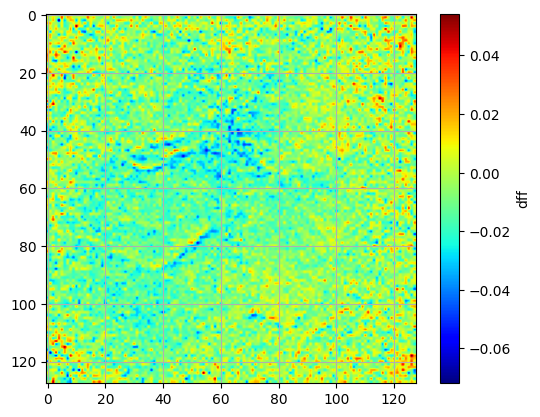

In [23]:
#plot of spatial signal without spatial smoothing
non_smoothed = plot_frame(dff_signal, frame_number, cmap = "jet", color_label = "dff")

#### 6A.2: spatial smoothing applied (gaussian, 3 pixels)

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

  1%|▋                                                                                 | 1/128 [00:00<00:46,  2.74it/s]

  2%|█▎                                                                                | 2/128 [00:00<00:38,  3.28it/s]

  2%|█▉                                                                                | 3/128 [00:00<00:41,  3.04it/s]

  3%|██▌                                                                               | 4/128 [00:01<00:40,  3.07it/s]

  4%|███▏                                                                              | 5/128 [00:01<00:37,  3.24it/s]

  5%|███▊                                                                              | 6/128 [00:01<00:36,  3.35it/s]

  5%|████▍                                                                             | 7/128 [00:02<00:37,  3.22it/s]

  6%|█████▏                                                                            | 8/128 [00:02<00:38,  3.11it/s]

  7%|█████▊                                                                            | 9/128 [00:02<00:38,  3.12it/s]

  8%|██████▎                                                                          | 10/128 [00:03<00:37,  3.11it/s]

  9%|██████▉                                                                          | 11/128 [00:03<00:35,  3.26it/s]

  9%|███████▌                                                                         | 12/128 [00:03<00:36,  3.21it/s]

 10%|████████▏                                                                        | 13/128 [00:04<00:35,  3.25it/s]

 11%|████████▊                                                                        | 14/128 [00:04<00:34,  3.26it/s]

 12%|█████████▍                                                                       | 15/128 [00:04<00:34,  3.30it/s]

 12%|██████████▏                                                                      | 16/128 [00:04<00:34,  3.28it/s]

 13%|██████████▊                                                                      | 17/128 [00:05<00:33,  3.31it/s]

 14%|███████████▍                                                                     | 18/128 [00:05<00:34,  3.22it/s]

 15%|████████████                                                                     | 19/128 [00:05<00:33,  3.28it/s]

 16%|████████████▋                                                                    | 20/128 [00:06<00:33,  3.20it/s]

 16%|█████████████▎                                                                   | 21/128 [00:06<00:33,  3.17it/s]

 17%|█████████████▉                                                                   | 22/128 [00:06<00:33,  3.15it/s]

 18%|██████████████▌                                                                  | 23/128 [00:07<00:32,  3.25it/s]

 19%|███████████████▏                                                                 | 24/128 [00:07<00:32,  3.16it/s]

 20%|███████████████▊                                                                 | 25/128 [00:07<00:31,  3.22it/s]

 20%|████████████████▍                                                                | 26/128 [00:08<00:30,  3.36it/s]

 21%|█████████████████                                                                | 27/128 [00:08<00:30,  3.31it/s]

 22%|█████████████████▋                                                               | 28/128 [00:08<00:30,  3.33it/s]

 23%|██████████████████▎                                                              | 29/128 [00:08<00:29,  3.34it/s]

 23%|██████████████████▉                                                              | 30/128 [00:09<00:28,  3.45it/s]

 24%|███████████████████▌                                                             | 31/128 [00:09<00:27,  3.55it/s]

 25%|████████████████████▎                                                            | 32/128 [00:09<00:28,  3.41it/s]

 26%|████████████████████▉                                                            | 33/128 [00:10<00:28,  3.34it/s]

 27%|█████████████████████▌                                                           | 34/128 [00:10<00:27,  3.41it/s]

 27%|██████████████████████▏                                                          | 35/128 [00:10<00:26,  3.45it/s]

 28%|██████████████████████▊                                                          | 36/128 [00:10<00:26,  3.46it/s]

 29%|███████████████████████▍                                                         | 37/128 [00:11<00:25,  3.53it/s]

 30%|████████████████████████                                                         | 38/128 [00:11<00:24,  3.65it/s]

 30%|████████████████████████▋                                                        | 39/128 [00:11<00:24,  3.63it/s]

 31%|█████████████████████████▎                                                       | 40/128 [00:12<00:24,  3.57it/s]

 32%|█████████████████████████▉                                                       | 41/128 [00:12<00:24,  3.55it/s]

 33%|██████████████████████████▌                                                      | 42/128 [00:12<00:23,  3.64it/s]

 34%|███████████████████████████▏                                                     | 43/128 [00:12<00:24,  3.51it/s]

 34%|███████████████████████████▊                                                     | 44/128 [00:13<00:23,  3.55it/s]

 35%|████████████████████████████▍                                                    | 45/128 [00:13<00:23,  3.55it/s]

 36%|█████████████████████████████                                                    | 46/128 [00:13<00:22,  3.57it/s]

 37%|█████████████████████████████▋                                                   | 47/128 [00:14<00:23,  3.44it/s]

 38%|██████████████████████████████▍                                                  | 48/128 [00:14<00:24,  3.23it/s]

 38%|███████████████████████████████                                                  | 49/128 [00:14<00:24,  3.25it/s]

 39%|███████████████████████████████▋                                                 | 50/128 [00:15<00:23,  3.29it/s]

 40%|████████████████████████████████▎                                                | 51/128 [00:15<00:23,  3.24it/s]

 41%|████████████████████████████████▉                                                | 52/128 [00:15<00:22,  3.32it/s]

 41%|█████████████████████████████████▌                                               | 53/128 [00:15<00:22,  3.37it/s]

 42%|██████████████████████████████████▏                                              | 54/128 [00:16<00:21,  3.37it/s]

 43%|██████████████████████████████████▊                                              | 55/128 [00:16<00:22,  3.22it/s]

 44%|███████████████████████████████████▍                                             | 56/128 [00:16<00:23,  3.08it/s]

 45%|████████████████████████████████████                                             | 57/128 [00:17<00:22,  3.15it/s]

 45%|████████████████████████████████████▋                                            | 58/128 [00:17<00:21,  3.21it/s]

 46%|█████████████████████████████████████▎                                           | 59/128 [00:17<00:21,  3.23it/s]

 47%|█████████████████████████████████████▉                                           | 60/128 [00:18<00:20,  3.27it/s]

 48%|██████████████████████████████████████▌                                          | 61/128 [00:18<00:20,  3.21it/s]

 48%|███████████████████████████████████████▏                                         | 62/128 [00:18<00:20,  3.27it/s]

 49%|███████████████████████████████████████▊                                         | 63/128 [00:19<00:20,  3.24it/s]

 50%|████████████████████████████████████████▌                                        | 64/128 [00:19<00:19,  3.23it/s]

 51%|█████████████████████████████████████████▏                                       | 65/128 [00:19<00:18,  3.35it/s]

 52%|█████████████████████████████████████████▊                                       | 66/128 [00:19<00:18,  3.33it/s]

 52%|██████████████████████████████████████████▍                                      | 67/128 [00:20<00:18,  3.32it/s]

 53%|███████████████████████████████████████████                                      | 68/128 [00:20<00:19,  3.15it/s]

 54%|███████████████████████████████████████████▋                                     | 69/128 [00:20<00:18,  3.27it/s]

 55%|████████████████████████████████████████████▎                                    | 70/128 [00:21<00:17,  3.29it/s]

 55%|████████████████████████████████████████████▉                                    | 71/128 [00:21<00:17,  3.29it/s]

 56%|█████████████████████████████████████████████▌                                   | 72/128 [00:21<00:17,  3.23it/s]

 57%|██████████████████████████████████████████████▏                                  | 73/128 [00:22<00:16,  3.25it/s]

 58%|██████████████████████████████████████████████▊                                  | 74/128 [00:22<00:16,  3.30it/s]

 59%|███████████████████████████████████████████████▍                                 | 75/128 [00:22<00:15,  3.33it/s]

 59%|████████████████████████████████████████████████                                 | 76/128 [00:22<00:15,  3.42it/s]

 60%|████████████████████████████████████████████████▋                                | 77/128 [00:23<00:15,  3.27it/s]

 61%|█████████████████████████████████████████████████▎                               | 78/128 [00:23<00:14,  3.38it/s]

 62%|█████████████████████████████████████████████████▉                               | 79/128 [00:23<00:14,  3.37it/s]

 62%|██████████████████████████████████████████████████▋                              | 80/128 [00:24<00:14,  3.26it/s]

 63%|███████████████████████████████████████████████████▎                             | 81/128 [00:24<00:14,  3.18it/s]

 64%|███████████████████████████████████████████████████▉                             | 82/128 [00:24<00:15,  3.05it/s]

 65%|████████████████████████████████████████████████████▌                            | 83/128 [00:25<00:14,  3.16it/s]

 66%|█████████████████████████████████████████████████████▏                           | 84/128 [00:25<00:14,  3.10it/s]

 66%|█████████████████████████████████████████████████████▊                           | 85/128 [00:25<00:13,  3.21it/s]

 67%|██████████████████████████████████████████████████████▍                          | 86/128 [00:26<00:13,  3.13it/s]

 68%|███████████████████████████████████████████████████████                          | 87/128 [00:26<00:13,  3.12it/s]

 69%|███████████████████████████████████████████████████████▋                         | 88/128 [00:26<00:13,  3.07it/s]

 70%|████████████████████████████████████████████████████████▎                        | 89/128 [00:27<00:12,  3.18it/s]

 70%|████████████████████████████████████████████████████████▉                        | 90/128 [00:27<00:11,  3.26it/s]

 71%|█████████████████████████████████████████████████████████▌                       | 91/128 [00:27<00:11,  3.31it/s]

 72%|██████████████████████████████████████████████████████████▏                      | 92/128 [00:27<00:10,  3.36it/s]

 73%|██████████████████████████████████████████████████████████▊                      | 93/128 [00:28<00:10,  3.39it/s]

 73%|███████████████████████████████████████████████████████████▍                     | 94/128 [00:28<00:09,  3.49it/s]

 74%|████████████████████████████████████████████████████████████                     | 95/128 [00:28<00:09,  3.53it/s]

 75%|████████████████████████████████████████████████████████████▊                    | 96/128 [00:29<00:09,  3.36it/s]

 76%|█████████████████████████████████████████████████████████████▍                   | 97/128 [00:29<00:09,  3.44it/s]

 77%|██████████████████████████████████████████████████████████████                   | 98/128 [00:29<00:08,  3.38it/s]

 77%|██████████████████████████████████████████████████████████████▋                  | 99/128 [00:30<00:08,  3.30it/s]

 78%|██████████████████████████████████████████████████████████████▌                 | 100/128 [00:30<00:08,  3.42it/s]

 79%|███████████████████████████████████████████████████████████████▏                | 101/128 [00:30<00:07,  3.43it/s]

 80%|███████████████████████████████████████████████████████████████▊                | 102/128 [00:30<00:07,  3.40it/s]

 80%|████████████████████████████████████████████████████████████████▍               | 103/128 [00:31<00:07,  3.36it/s]

 81%|█████████████████████████████████████████████████████████████████               | 104/128 [00:31<00:07,  3.24it/s]

 82%|█████████████████████████████████████████████████████████████████▋              | 105/128 [00:31<00:07,  3.28it/s]

 83%|██████████████████████████████████████████████████████████████████▎             | 106/128 [00:32<00:06,  3.36it/s]

 84%|██████████████████████████████████████████████████████████████████▉             | 107/128 [00:32<00:06,  3.44it/s]

 84%|███████████████████████████████████████████████████████████████████▌            | 108/128 [00:32<00:05,  3.38it/s]

 85%|████████████████████████████████████████████████████████████████████▏           | 109/128 [00:32<00:05,  3.35it/s]

 86%|████████████████████████████████████████████████████████████████████▊           | 110/128 [00:33<00:05,  3.42it/s]

 87%|█████████████████████████████████████████████████████████████████████▍          | 111/128 [00:33<00:04,  3.51it/s]

 88%|██████████████████████████████████████████████████████████████████████          | 112/128 [00:33<00:04,  3.41it/s]

 88%|██████████████████████████████████████████████████████████████████████▋         | 113/128 [00:34<00:04,  3.47it/s]

 89%|███████████████████████████████████████████████████████████████████████▎        | 114/128 [00:34<00:04,  3.40it/s]

 90%|███████████████████████████████████████████████████████████████████████▉        | 115/128 [00:34<00:03,  3.29it/s]

 91%|████████████████████████████████████████████████████████████████████████▌       | 116/128 [00:35<00:03,  3.34it/s]

 91%|█████████████████████████████████████████████████████████████████████████▏      | 117/128 [00:35<00:03,  3.38it/s]

 92%|█████████████████████████████████████████████████████████████████████████▊      | 118/128 [00:35<00:02,  3.46it/s]

 93%|██████████████████████████████████████████████████████████████████████████▍     | 119/128 [00:35<00:02,  3.51it/s]

 94%|███████████████████████████████████████████████████████████████████████████     | 120/128 [00:36<00:02,  3.42it/s]

 95%|███████████████████████████████████████████████████████████████████████████▋    | 121/128 [00:36<00:02,  3.43it/s]

 95%|████████████████████████████████████████████████████████████████████████████▎   | 122/128 [00:36<00:01,  3.34it/s]

 96%|████████████████████████████████████████████████████████████████████████████▉   | 123/128 [00:37<00:01,  3.44it/s]

 97%|█████████████████████████████████████████████████████████████████████████████▌  | 124/128 [00:37<00:01,  3.38it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▏ | 125/128 [00:37<00:00,  3.34it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▊ | 126/128 [00:37<00:00,  3.33it/s]

 99%|███████████████████████████████████████████████████████████████████████████████▍| 127/128 [00:38<00:00,  3.40it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:38<00:00,  3.41it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:38<00:00,  3.32it/s]

frame number 200 plotted


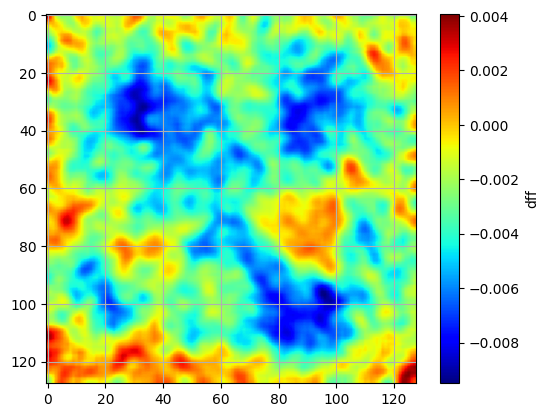

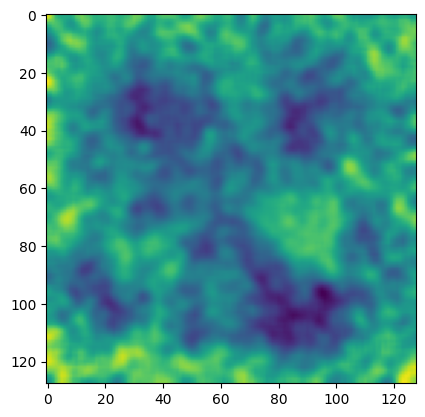

In [24]:
#plot of spatial resolution including spatial smoothing
smoothed_signal = smoothing(dff_signal)
plot_frame(smoothed_signal, 200, cmap = "jet", color_label = "dff")
plt.imshow(smoothed_signal[201])

### 6B: Temporal filtering

dff plot with chebyshev type 1 temporal filtering (high and low bandpass filter)

In [25]:
interactive_plot(smoothed_signal.mean(axis=(1,2)), title_label = "temporally smoothed signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 7: ROI plotting

### 7A: ROI full frame

plotting single flash full frame mean

In [26]:
full_roi_single, full_single_segments = avg_trials(single_indices, smoothed_signal, double=False, segment_size=200, minus=20)

In [27]:
interactive_plot(full_roi_single.mean(axis=(1,2)), title_label = "full frame single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash full frame mean

In [28]:
full_roi_double, full_double_segments = avg_trials(double_indices, smoothed_signal, double=True, segment_size=200, minus=20)

In [29]:
interactive_plot(full_roi_double.mean(axis=(1,2)), title_label = "full frame double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting NOGO full frame mean

Need to import the text file to know the location of the nogo trials

In [30]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

successfully loaded txt file


In [31]:
nogo_trials = extract_nogo(txt_file)

# nogo trials: 27


plotting nogo trials

In [32]:
full_roi_nogo, full_nogo_segments = avg_trials(nogo_trials, smoothed_signal, double=False, segment_size=200, minus=20)

In [33]:
interactive_plot(full_roi_nogo.mean(axis=(1,2)), title_label = "full frame NOGO average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

### 7B: V1 ROI

within all of v1 area at the back of the cortex the peak value at 5 frames is taken as the central point and a 15x15 grid is placed around the peak value

plotting single flash just v1 10x10 mean

In [34]:
v1_area_single = extract_v1(full_roi_single, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [35]:
interactive_plot(v1_area_single.mean(axis=(1,2)), title_label = "v1 single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash just v1 10x10 mean

In [36]:
v1_area_double = extract_v1(full_roi_double, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [37]:
interactive_plot(v1_area_double.mean(axis=(1,2)), title_label = "v1 double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 8: Line up to txt file and success vs fail rate

#### Step 8A: load in txt file from Pi_data folder

In [38]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

#extract single, double or nogo columns from the txt file
single_txt, double_txt, nogo_txt = extract_success(txt_file)

successfully loaded txt file


#### Step 8B: take the dff signal and sort them into arrays based on success or fail

In [39]:
single_success, single_fail = sort_success(single_txt, full_single_segments)

success = 34
fail = 0
total trials = 34


In [40]:
double_success, double_fail = sort_success(double_txt, full_double_segments)

success = 35
fail = 4
total trials = 39


In [41]:
nogo_success, nogo_fail = sort_success(nogo_txt, full_nogo_segments)

success = 3
fail = 24
total trials = 27


## Step 9: Save the 3D array as a TIFF stack

In [42]:
save_tiff(smoothed_signal, tiff_path_full) # full frame whole session tiff stack
save_tiff(full_roi_single, tiff_path_single) #SINGLE flash averaged response over all trials tiff stack file name to save
save_tiff(full_roi_double, tiff_path_double) #DOUBLE flash averaged response over all trials tiff stack file name to save

  0%|                                                                                        | 0/33689 [00:00<?, ?it/s]

  7%|█████▎                                                                    | 2433/33689 [00:00<00:01, 24097.28it/s]

 15%|███████████                                                               | 5009/33689 [00:00<00:01, 24930.38it/s]

 24%|█████████████████▍                                                        | 7917/33689 [00:00<00:00, 26698.17it/s]

 31%|██████████████████████▉                                                  | 10587/33689 [00:00<00:00, 23559.21it/s]

 39%|████████████████████████████▏                                            | 12990/33689 [00:00<00:00, 21838.69it/s]

 45%|████████████████████████████████▉                                        | 15215/33689 [00:00<00:00, 21132.49it/s]

 53%|██████████████████████████████████████▉                                  | 17969/33689 [00:00<00:00, 22952.76it/s]

 60%|███████████████████████████████████████████▉                             | 20300/33689 [00:00<00:00, 22858.11it/s]

 68%|█████████████████████████████████████████████████▋                       | 22930/33689 [00:00<00:00, 23805.37it/s]

 75%|██████████████████████████████████████████████████████▉                  | 25332/33689 [00:01<00:00, 23455.07it/s]

 82%|████████████████████████████████████████████████████████████             | 27693/33689 [00:01<00:00, 23365.72it/s]

 90%|█████████████████████████████████████████████████████████████████▉       | 30407/33689 [00:01<00:00, 24406.68it/s]

 98%|███████████████████████████████████████████████████████████████████████▏ | 32858/33689 [00:01<00:00, 23469.55it/s]

100%|█████████████████████████████████████████████████████████████████████████| 33689/33689 [00:01<00:00, 23451.92it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 25007.03it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 22231.49it/s]

Combined TIFF stack saved successfully.


### Step 9B: Pickle for uploading into other scripts

In [43]:
# Now you can use these file paths in your code
with open(pickle_single_v1, 'wb') as f:
    pickle.dump(v1_area_single, f)

with open(pickle_double_v1, 'wb') as f:
    pickle.dump(v1_area_double, f)

with open(pickle_single_success_ff, 'wb') as f:
    pickle.dump(single_success, f)

with open(pickle_single_fail_ff, 'wb') as f:
    pickle.dump(single_fail, f)

with open(pickle_double_success_ff, 'wb') as f:
    pickle.dump(double_success, f)

with open(pickle_double_fail_ff, 'wb') as f:
    pickle.dump(double_fail, f)

with open(pickle_nogo_success_ff, 'wb') as f:
    pickle.dump(nogo_success, f)

with open(pickle_nogo_fail_ff, 'wb') as f:
    pickle.dump(nogo_fail, f)

# Mask and animate figures

#### currently not using these, good for visualization and flair

In [44]:
#masking = load_masks(dff_signal)
#mask, mask_outline = masking[0], masking[1]

#masked_smoothed_signal = smoothed_signal*mask
#masked_full_roi_single = full_roi_single*mask
#masked_full_roi_double = full_roi_double*mask

In [45]:
#file_path_ = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts.tiff"
#save_tiff(masked_smoothed_signal, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_single.tiff"
#save_tiff(masked_full_roi_single, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_double.tiff"
#save_tiff(masked_full_roi_double, file_path)

#print(f"TIFF stack saved at: {file_path}")